In [51]:
import pandas as pd
import os
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import json
from IPython.display import display, Markdown
from scipy.stats import pearsonr, spearmanr, ks_2samp, mannwhitneyu

import sys
sys.path.append('../')

import utils
from evalutils.roc import get_bootstrapped_roc_ci_curves
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

## directory where results are
EXPERIMENT_DIR = f"/data/bodyct/experiments/lung-malignancy-fairness-shaurya"
NLST_PREDS = f"{EXPERIMENT_DIR}/nlst"

TEAMS_DIR = "C:/Users/shaur/OneDrive - Radboudumc/Documents - Master - Shaurya Gaur/General/Malignancy-Estimation Results/nlst"
NLST_PREDS = TEAMS_DIR ## Comment out if not using Teams backup (aka Chansey is up :)

In [52]:
nlst_preds_nodule = pd.read_csv(f"{NLST_PREDS}/nlst_demov2_allmodels.csv")
nlst_preds_nodule.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 16077 entries, 0 to 16076
Columns: 102 entries, PatientID to Married
dtypes: bool(10), float64(77), int64(11), object(4)
memory usage: 11.4+ MB


In [53]:
with open(f'{NLST_PREDS}/nlst_demo_v2_cols.json') as json_data:
    nlst_democols = json.load(json_data)
    json_data.close()

In [ ]:
nlst_preds = utils.prep_nlst_preds(nlst_preds_nodule, scanlevel=True, tijmen=False, sybil=True)
nlst_preds.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1172 entries, 4740 to 10150
Data columns (total 96 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   PatientID              1172 non-null   int64  
 1   StudyDate              1172 non-null   int64  
 2   SeriesInstanceUID      1172 non-null   object 
 3   LesionID               1172 non-null   int64  
 4   Spiculation            1172 non-null   bool   
 5   Diameter [mm]          1172 non-null   float64
 6   Age                    1172 non-null   int64  
 7   Gender                 1172 non-null   int64  
 8   FamilyHistoryLungCa    1172 non-null   bool   
 9   Emphysema              1172 non-null   bool   
 10  NoduleInUpperLung      1172 non-null   bool   
 11  NoduleCounts           1172 non-null   int64  
 12  SCT_EPI_LOC            1119 non-null   float64
 13  xie_gc_gclobe150       53 non-null     float64
 14  loclup                 127 non-null    float64
 15  locru

c:\Users\shaur\Documents\bodyct-lung-malignancy-fairness\utils.py:278: FutureWarning: The provided callable <built-in function max> is currently using SeriesGroupBy.max. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "max" instead.
  df[c] = dfgb[c].transform(max)
c:\Users\shaur\Documents\bodyct-lung-malignancy-fairness\utils.py:278: FutureWarning: The provided callable <built-in function max> is currently using SeriesGroupBy.max. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "max" instead.
  df[c] = dfgb[c].transform(max)


In [ ]:
MODEL_TO_COL = {
    "Venkadesh": "DL",
    # "de Haas Combined": "Thijmen_mean",
    "de Haas Local": "Thijmen_local",
    "de Haas Global (hidden nodule)": "Thijmen_global_hidden",
    # "de Haas Global (shown nodule)": "Thijmen_global_show",
    "Sybil": "sybil_year1",
    "PanCan2b": "PanCan2b",
}

## Plot results by category

In [56]:
def modelstats_by_cat(df, cat, models=MODEL_TO_COL):
    groups = df.groupby(cat)
    
    df_catinfo, _ = utils.info_by_splits(groups, min_mal=0)
    for m in models:
        means, stds = {}, {}
        for val, df_group in groups:
            means[val] = df_group[models[m]].mean()
            stds[val] = df_group[models[m]].std()
        df_catinfo[f'{m}_mean'] = means
        df_catinfo[f'{m}_std'] = stds

    return df_catinfo

In [57]:
sigtest =  mannwhitneyu

In [58]:
def dist_sig_by_cat(df, cat, models=MODEL_TO_COL):
    groups = df.groupby(cat)
    result = {}
    for m in models:
        display(Markdown(f"#### {m}"))
        stats, pvals = {}, {}

        for a, dfa in groups:
            stats[a] = {a: 0}
            pvals[a] = {a: 1} 
            for b, dfb in groups:
                if a == b: continue
                res = sigtest(dfa[models[m]], dfb[models[m]], nan_policy='omit', alternative='two-sided')
                stats[a][b] = res.statistic
                pvals[a][b] = res.pvalue
        
        stats_df = pd.DataFrame(stats)
        print("Statistics:")
        display(stats_df)

        pvals_df = pd.DataFrame(pvals)
        print("P-Values:")
        display(pvals_df)

        result[m] = {'stats': stats_df, 'pvals': pvals_df}
    
    return result

def dist_sig_by_cat_and_mal(df, cat, models=MODEL_TO_COL):
    display(Markdown(f"### Benign"))
    benign_result = dist_sig_by_cat(df.query('label == 0'), cat, models)
    display(Markdown(f"### Malignant"))
    malignant_result = dist_sig_by_cat(df.query('label == 1'), cat, models)
    return benign_result, malignant_result

In [59]:
def dist_by_category(df, cat, models=MODEL_TO_COL):
    fig, ax = plt.subplots(2, len(models), figsize=(6.5*len(models) - 0.5, 13))
    fig.suptitle(f'Model Scores Split by {cat} (top: benign, bottom: malignant)')
    df_by_label = df.groupby('label')
    catvals = df[cat].dropna().unique()

    for j, dfj in df_by_label:
        for i, m in enumerate(models):
            sns.histplot(data=dfj, ax=ax[j][i], x=models[m], hue=cat, common_norm=False, element='poly', stat='density')
            ax[j][i].set_title(f'{m}')
            # ax[j][i].legend([f'{v}: (m={np.around(dfj[dfj[cat] == v].mean(), 4)}, s={np.around(dfj[dfj[cat] == v].std(), 4)})' for v in catvals])
            
            if len(catvals) == 2:
                sample0 = dfj[dfj[cat] == catvals[0]][models[m]]
                sample1 = dfj[dfj[cat] == catvals[1]][models[m]]
                res = sigtest(sample0, sample1, alternative='two-sided', nan_policy='omit')
                ax[j][i].set_title(f'{m}: (z={np.around(res.statistic, 6)}, p={np.around(res.pvalue, 6)})')
    
    plt.tight_layout()
    plt.show()

In [60]:
def plot_by_category(df, c):
    display(Markdown(f"### {c}"))
    display(modelstats_by_cat(nlst_preds, c))
    dist_by_category(nlst_preds, c)
    # dist_sig_by_cat_and_mal(nlst_preds, c)
    # dist_sig_by_cat(nlst_preds, c)

### Included columns (from predictions)

### wrknomask

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Combined_mean,de Haas Combined_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,de Haas Global (shown nodule)_mean,de Haas Global (shown nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
False,872,74.40273,102,11.697248,0.235876,0.339027,0.230629,0.315600,0.274815,0.357045,0.290110,0.332746,0.195628,0.334127,0.037474,0.090209,0.073670,0.107844
True,300,25.59727,25,8.333333,0.218928,0.341674,0.189138,0.294567,0.230964,0.336190,0.291982,0.349013,0.211566,0.338918,0.033954,0.087508,0.064321,0.104923


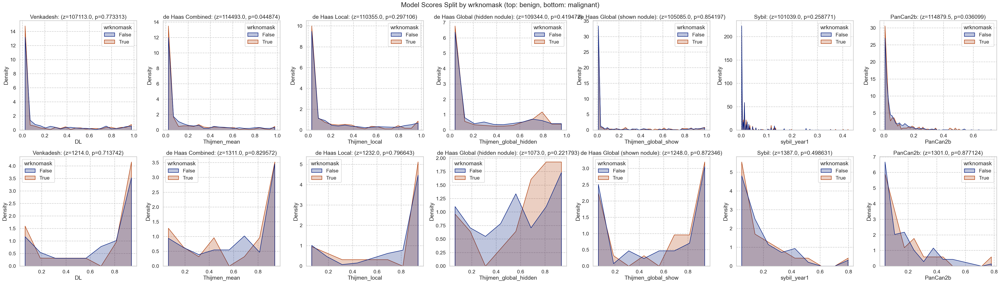

### FamilyHistoryLungCa

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Combined_mean,de Haas Combined_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,de Haas Global (shown nodule)_mean,de Haas Global (shown nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
False,870,74.232082,87,10.000000,0.22934,0.336941,0.215883,0.306244,0.257981,0.346720,0.281828,0.331571,0.190011,0.32789,0.032806,0.077729,0.065903,0.099484
True,302,25.767918,40,13.245033,0.23787,0.347791,0.231895,0.323632,0.279749,0.367656,0.315826,0.350901,0.227641,0.35482,0.047426,0.116455,0.086758,0.125530


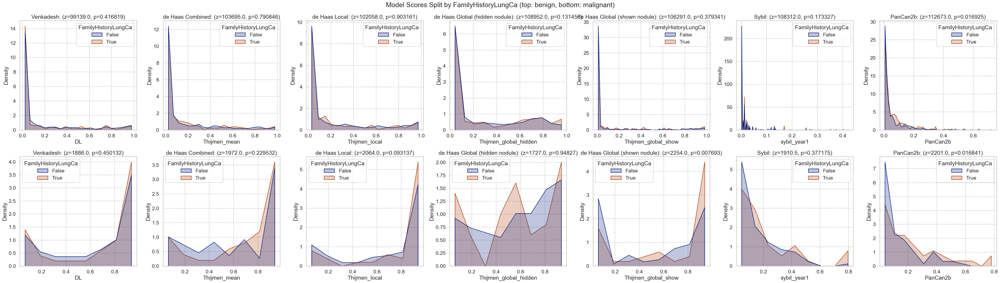

### PersonalCancerHist

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Combined_mean,de Haas Combined_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,de Haas Global (shown nodule)_mean,de Haas Global (shown nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
False,824,70.307167,80,9.708738,0.229596,0.336156,0.216400,0.306042,0.259931,0.346878,0.278879,0.332674,0.192126,0.328959,0.030996,0.072398,0.064336,0.097576
True,348,29.692833,47,13.505747,0.236137,0.348201,0.228553,0.321933,0.272255,0.364866,0.318315,0.345391,0.217658,0.349642,0.049778,0.119801,0.087711,0.125572


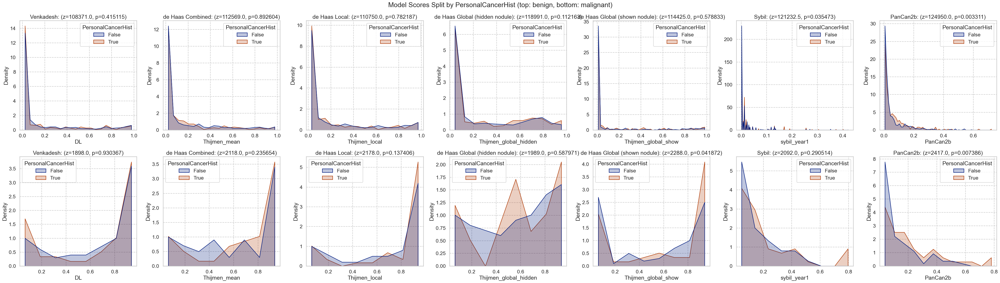

In [61]:
for c in nlst_democols['cat']['other']:
    plot_by_category(nlst_preds, c)

### Demographics

### marital

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Combined_mean,de Haas Combined_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,de Haas Global (shown nodule)_mean,de Haas Global (shown nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
1.0,46,3.924915,0,0.000000,0.248638,0.342122,0.182340,0.297256,0.202512,0.329258,0.333355,0.369227,0.256370,0.381521,0.017823,0.049143,0.104592,0.123395
2.0,785,66.979522,86,10.955414,0.222288,0.335266,0.212114,0.308252,0.250646,0.345621,0.282151,0.331338,0.192361,0.329658,0.037682,0.091612,0.065335,0.104345
3.0,120,10.238908,14,11.666667,0.277650,0.372836,0.277155,0.329331,0.315769,0.375429,0.274041,0.339529,0.205429,0.351380,0.050128,0.120903,0.078854,0.114822
4.0,19,1.621160,5,26.315789,0.299977,0.412234,0.244199,0.319559,0.342257,0.381817,0.287383,0.317418,0.188229,0.330487,0.017034,0.031483,0.049540,0.045854
5.0,202,17.235495,22,10.891089,0.229760,0.328304,0.223042,0.310257,0.289405,0.362756,0.323773,0.350731,0.213032,0.338260,0.030316,0.066169,0.084325,0.111170


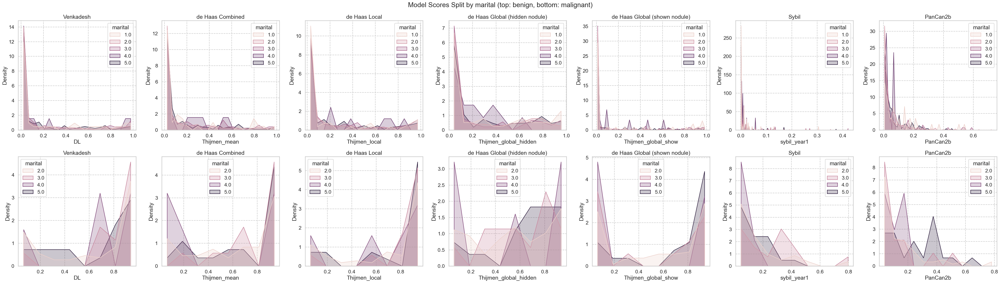

### educat

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Combined_mean,de Haas Combined_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,de Haas Global (shown nodule)_mean,de Haas Global (shown nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
1.0,27,2.341717,4,14.814815,0.215479,0.327885,0.273592,0.290646,0.215054,0.313423,0.506763,0.334210,0.466297,0.410278,0.030404,0.071439,0.082556,0.111692
2.0,67,5.810928,2,2.985075,0.204338,0.321213,0.160654,0.236708,0.231367,0.328250,0.259555,0.363236,0.135105,0.270364,0.022543,0.056359,0.059132,0.064835
3.0,307,26.626193,36,11.726384,0.258004,0.350143,0.248911,0.335371,0.299133,0.367822,0.299443,0.340599,0.227615,0.354637,0.047622,0.112604,0.074899,0.113116
4.0,144,12.489159,16,11.111111,0.286072,0.358256,0.246434,0.338031,0.262971,0.347436,0.221589,0.315086,0.181007,0.315172,0.033756,0.085708,0.082008,0.135655
5.0,244,21.162186,31,12.704918,0.230831,0.344625,0.211268,0.314275,0.271470,0.368370,0.322786,0.336544,0.204110,0.335474,0.036665,0.077271,0.068350,0.098421
6.0,185,16.045100,21,11.351351,0.200189,0.330284,0.178748,0.272282,0.240498,0.335315,0.249677,0.322425,0.184212,0.326373,0.024337,0.056565,0.056770,0.082634
7.0,179,15.524718,16,8.938547,0.182904,0.311481,0.218399,0.305421,0.236936,0.341727,0.305297,0.334582,0.154274,0.306786,0.037538,0.100762,0.074413,0.114867


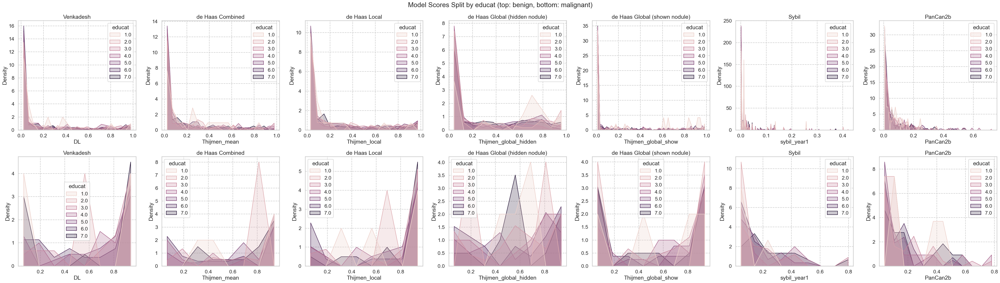

### race

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Combined_mean,de Haas Combined_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,de Haas Global (shown nodule)_mean,de Haas Global (shown nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
1.0,1098,93.926433,112,10.200364,0.224237,0.334422,0.216695,0.309602,0.255376,0.347567,0.289589,0.337638,0.197442,0.333365,0.035554,0.088994,0.068368,0.105282
2.0,40,3.421728,9,22.500000,0.275529,0.379154,0.275059,0.320252,0.351842,0.369603,0.277723,0.302146,0.188663,0.332202,0.039609,0.087032,0.120374,0.120017
3.0,7,0.598802,0,0.000000,0.301953,0.356580,0.017342,0.027753,0.241572,0.269743,0.040226,0.087484,0.000827,0.002186,0.002315,0.001694,0.054873,0.046118
4.0,10,0.855432,5,50.000000,0.698138,0.333341,0.438312,0.336994,0.713446,0.426035,0.496164,0.425437,0.640454,0.380601,0.148634,0.100302,0.111352,0.088036
5.0,3,0.256630,1,33.333333,0.896782,0.173333,0.870773,0.135664,0.986525,0.020469,0.550305,0.455271,0.462866,0.480586,0.144745,0.222565,0.427510,0.217317
6.0,11,0.940975,0,0.000000,0.209853,0.337714,0.119866,0.236294,0.227784,0.348219,0.257610,0.272258,0.004886,0.012783,0.026284,0.056881,0.061880,0.060603


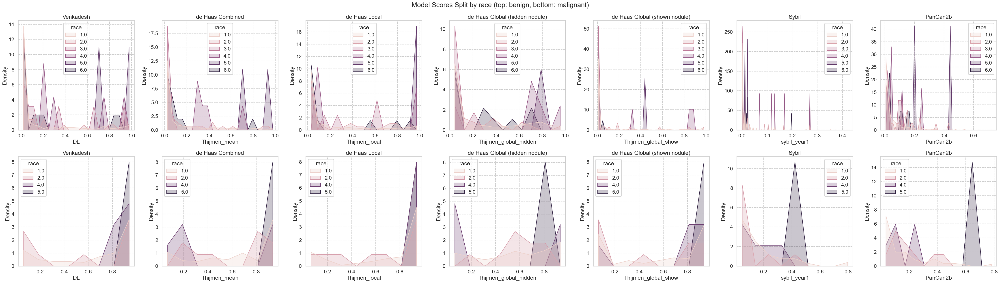

### ethnic

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Combined_mean,de Haas Combined_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,de Haas Global (shown nodule)_mean,de Haas Global (shown nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
1.0,11,0.940171,1,9.090909,0.335298,0.413880,0.222946,0.278744,0.167041,0.307530,0.479680,0.273828,0.490423,0.374893,0.034421,0.074497,0.093503,0.082961
2.0,1159,99.059829,126,10.871441,0.229938,0.338739,0.219919,0.311237,0.264163,0.352505,0.288679,0.336917,0.196444,0.333295,0.036637,0.089729,0.070723,0.106913


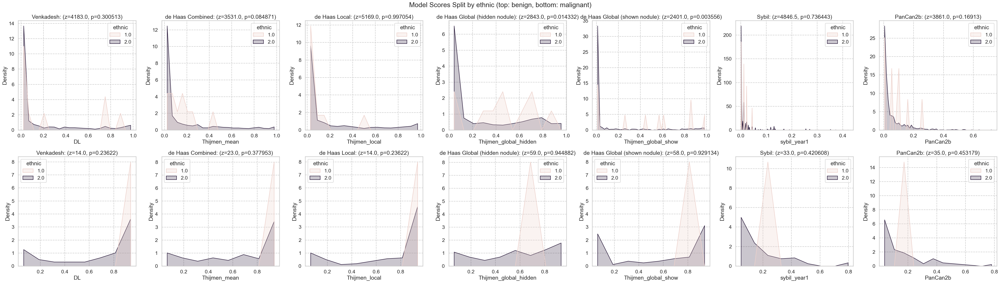

### Gender

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Combined_mean,de Haas Combined_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,de Haas Global (shown nodule)_mean,de Haas Global (shown nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
1,693,59.129693,79,11.399711,0.230980,0.336278,0.219807,0.317490,0.256582,0.348863,0.284097,0.341181,0.206781,0.341559,0.034018,0.084062,0.060145,0.093714
2,479,40.870307,48,10.020877,0.232346,0.344800,0.220300,0.301077,0.273729,0.357103,0.299981,0.330575,0.189473,0.326081,0.040269,0.096803,0.087382,0.122335


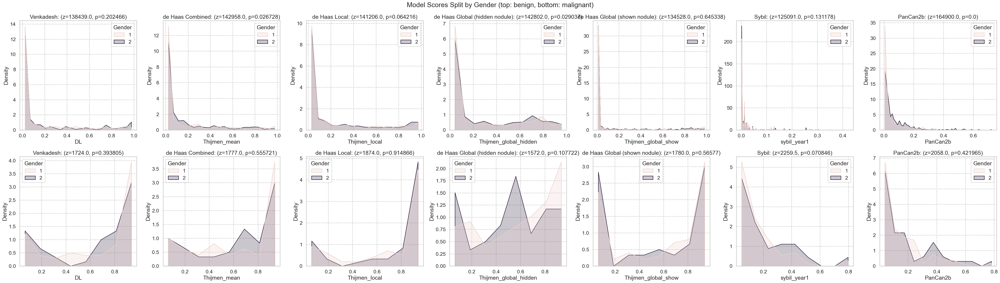

### Married

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Combined_mean,de Haas Combined_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,de Haas Global (shown nodule)_mean,de Haas Global (shown nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
False,387,33.020478,41,10.594315,0.250301,0.348030,0.236022,0.315572,0.289846,0.364233,0.307704,0.347524,0.214608,0.346377,0.034322,0.085131,0.083330,0.111759
True,785,66.979522,86,10.955414,0.222288,0.335266,0.212114,0.308252,0.250646,0.345621,0.282151,0.331338,0.192361,0.329658,0.037682,0.091612,0.065335,0.104345


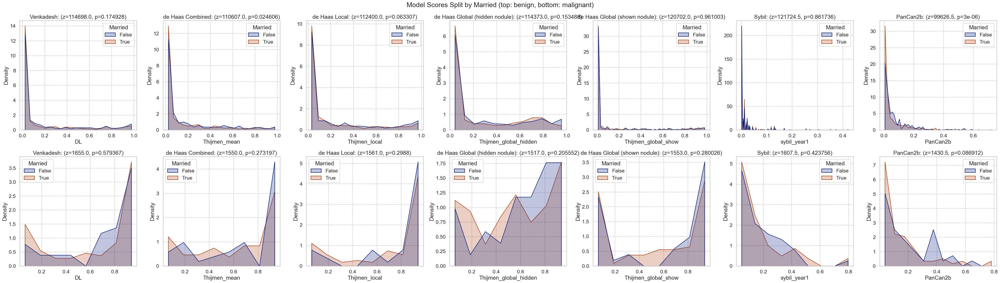

### NonHispanicWhite

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Combined_mean,de Haas Combined_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,de Haas Global (shown nodule)_mean,de Haas Global (shown nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
False,83,7.081911,16,19.277108,0.351161,0.395837,0.263745,0.322986,0.365295,0.394209,0.314622,0.324842,0.250528,0.367614,0.050516,0.094243,0.113424,0.120962
True,1089,92.918089,111,10.192837,0.222421,0.333425,0.216675,0.309705,0.255839,0.347777,0.288757,0.337806,0.195834,0.332559,0.035510,0.089086,0.068065,0.105382


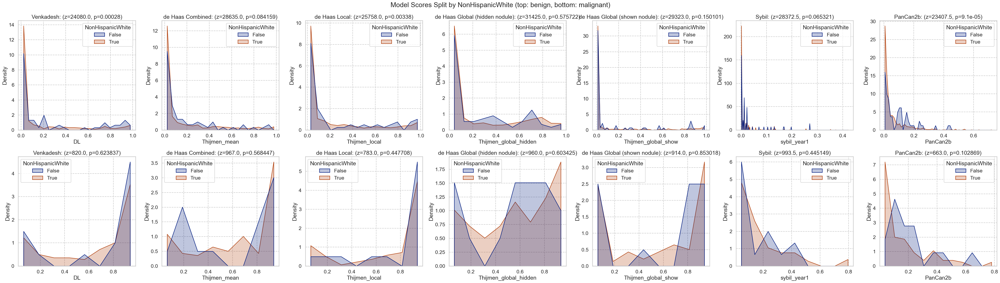

### HighSchoolPlus

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Combined_mean,de Haas Combined_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,de Haas Global (shown nodule)_mean,de Haas Global (shown nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
False,27,2.303754,4,14.814815,0.215479,0.327885,0.273592,0.290646,0.215054,0.313423,0.506763,0.334210,0.466297,0.410278,0.030404,0.071439,0.082556,0.111692
True,1145,97.696246,123,10.742358,0.231917,0.340043,0.218745,0.311223,0.264735,0.353108,0.285491,0.335362,0.193421,0.330950,0.036718,0.089904,0.071011,0.107064


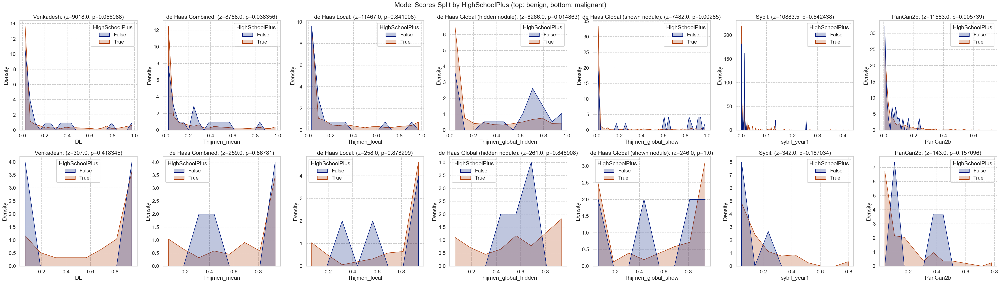

In [62]:
for cat in nlst_democols['cat']['demo']:
    plot_by_category(nlst_preds, cat)

### Smoking

### cigar

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Combined_mean,de Haas Combined_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,de Haas Global (shown nodule)_mean,de Haas Global (shown nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
0.0,931,79.845626,105,11.278195,0.243023,0.347823,0.228929,0.317284,0.277383,0.358545,0.297223,0.337996,0.197383,0.333740,0.038847,0.090757,0.075257,0.107834
1.0,235,20.154374,21,8.936170,0.188453,0.302809,0.185955,0.280272,0.211615,0.321040,0.267826,0.331038,0.209851,0.341181,0.026360,0.079970,0.056934,0.104275


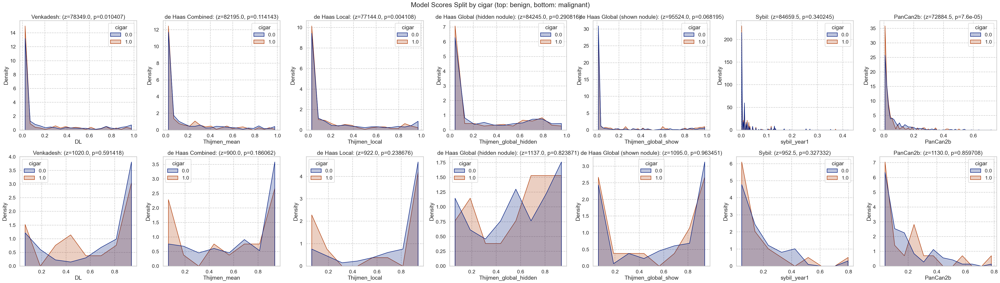

### cigsmok

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Combined_mean,de Haas Combined_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,de Haas Global (shown nodule)_mean,de Haas Global (shown nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
0,560,47.78157,46,8.214286,0.213819,0.323560,0.185844,0.285471,0.234657,0.328690,0.266810,0.329145,0.172581,0.311145,0.033198,0.085505,0.063242,0.095877
1,612,52.21843,81,13.235294,0.247751,0.353201,0.251271,0.329351,0.290065,0.370713,0.312347,0.342543,0.224529,0.354383,0.039661,0.092970,0.078629,0.116083


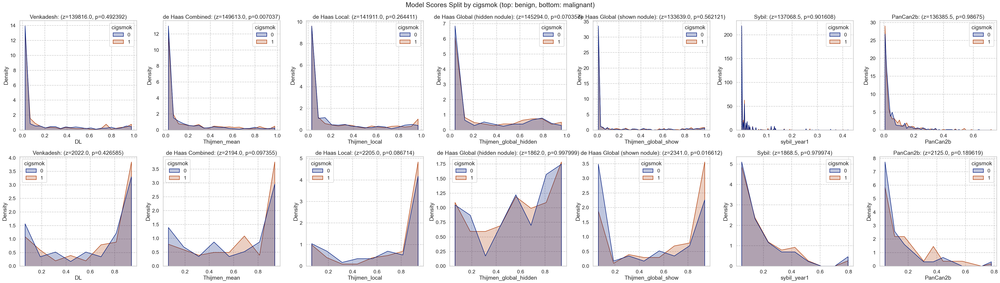

### pipe

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Combined_mean,de Haas Combined_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,de Haas Global (shown nodule)_mean,de Haas Global (shown nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
0.0,882,75.708155,87,9.863946,0.236106,0.342985,0.227584,0.314608,0.27070,0.354396,0.292948,0.336331,0.197029,0.334871,0.037114,0.086437,0.074614,0.108581
1.0,283,24.291845,39,13.780919,0.220071,0.330407,0.196358,0.296807,0.24223,0.344667,0.287147,0.338467,0.209536,0.336784,0.033813,0.096039,0.062258,0.103120


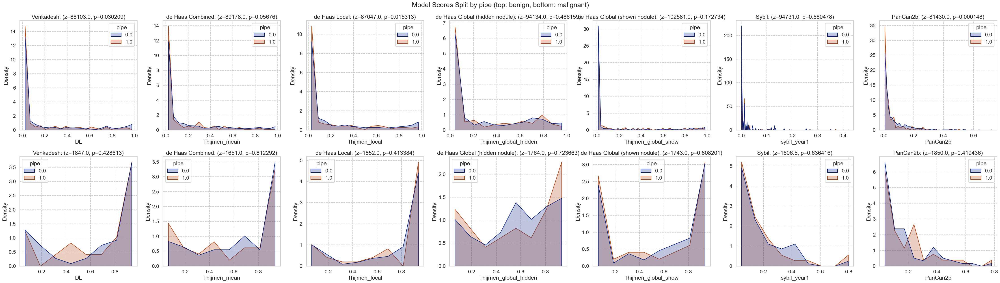

### smokelive

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Combined_mean,de Haas Combined_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,de Haas Global (shown nodule)_mean,de Haas Global (shown nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
0.0,139,11.910883,13,9.352518,0.236084,0.337030,0.203372,0.300463,0.248993,0.328270,0.248485,0.328033,0.193089,0.351043,0.034502,0.081576,0.074582,0.113884
1.0,1028,88.089117,113,10.992218,0.231039,0.339849,0.222285,0.311747,0.265850,0.355162,0.296725,0.337372,0.200615,0.332964,0.036874,0.090700,0.070865,0.106255


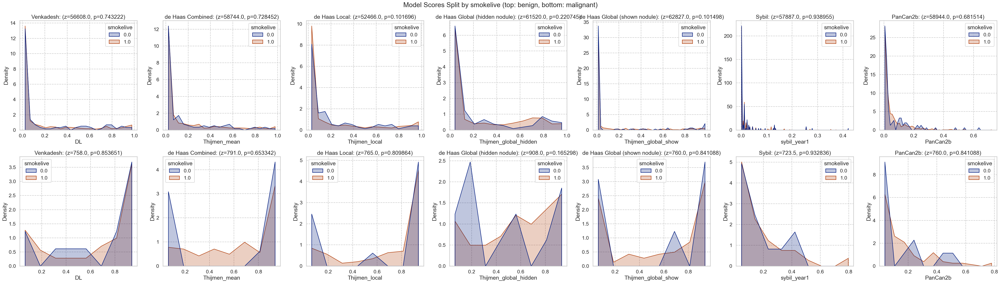

### smokework

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Combined_mean,de Haas Combined_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,de Haas Global (shown nodule)_mean,de Haas Global (shown nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
0.0,150,12.931034,16,10.666667,0.247729,0.339138,0.224211,0.295064,0.265541,0.341975,0.292389,0.324584,0.167242,0.306173,0.032302,0.092214,0.065726,0.093340
1.0,1010,87.068966,111,10.990099,0.230381,0.340862,0.220501,0.314001,0.265589,0.355148,0.291296,0.338304,0.204960,0.339688,0.037595,0.089577,0.072232,0.109353


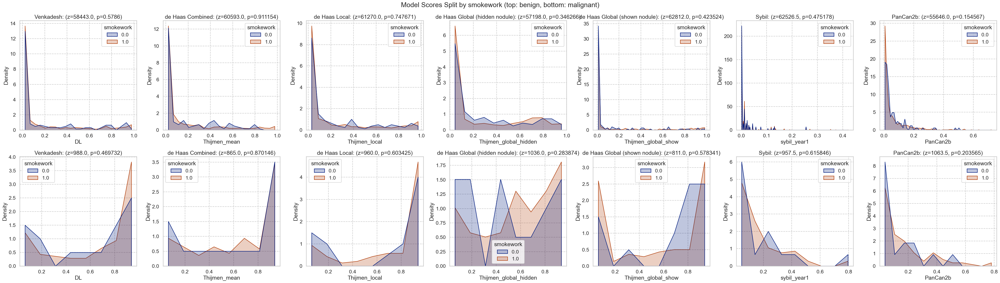

In [63]:
for cat in nlst_democols['cat']['smoke']:
    plot_by_category(nlst_preds, cat)

### Work history

### wrkasbe

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Combined_mean,de Haas Combined_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,de Haas Global (shown nodule)_mean,de Haas Global (shown nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
0.0,1082,92.320819,118,10.90573,0.223685,0.333865,0.215850,0.307308,0.257075,0.349361,0.289871,0.334436,0.196519,0.331936,0.035101,0.085567,0.070508,0.107822
1.0,90,7.679181,9,10.00000,0.325946,0.392608,0.270005,0.347576,0.341922,0.378078,0.299222,0.366346,0.238038,0.373127,0.054270,0.126978,0.080519,0.098619


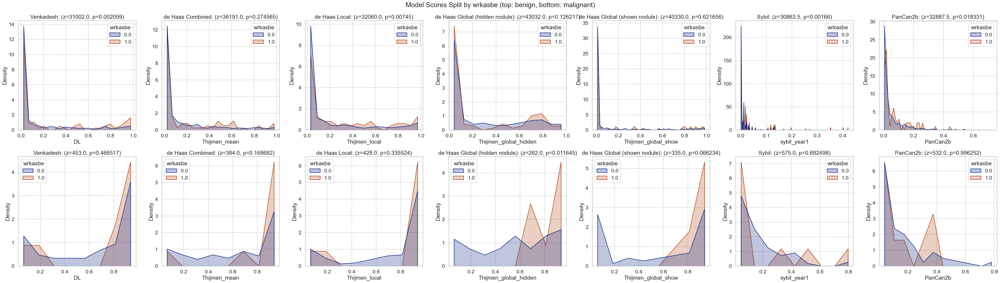

### wrkbaki

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Combined_mean,de Haas Combined_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,de Haas Global (shown nodule)_mean,de Haas Global (shown nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
0.0,1145,97.696246,124,10.829694,0.233411,0.340573,0.220387,0.311562,0.265372,0.353690,0.289551,0.336486,0.199961,0.335827,0.036944,0.090134,0.071120,0.107373
1.0,27,2.303754,3,11.111111,0.152118,0.291878,0.203954,0.279215,0.188035,0.276689,0.334594,0.355118,0.188962,0.317281,0.020849,0.055289,0.077923,0.098234


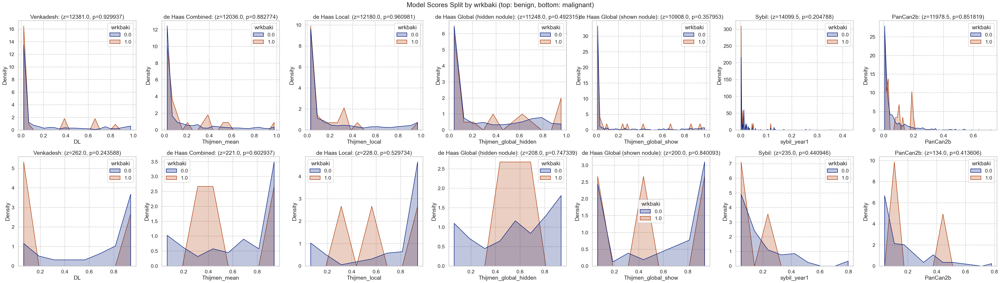

### wrkbutc

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Combined_mean,de Haas Combined_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,de Haas Global (shown nodule)_mean,de Haas Global (shown nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
0.0,1154,98.464164,124,10.745234,0.231393,0.339989,0.220028,0.310604,0.263678,0.352978,0.289955,0.336238,0.198219,0.333548,0.036664,0.089854,0.071116,0.107298
1.0,18,1.535836,3,16.666667,0.240854,0.325566,0.218809,0.329682,0.257948,0.307025,0.331209,0.381560,0.295137,0.433722,0.030715,0.064470,0.081608,0.098453


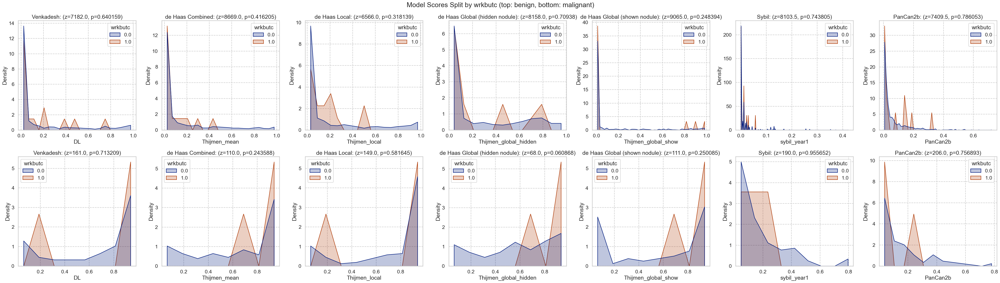

### wrkchem

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Combined_mean,de Haas Combined_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,de Haas Global (shown nodule)_mean,de Haas Global (shown nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
0.0,1087,92.826644,120,11.039558,0.232699,0.339151,0.224063,0.312123,0.268310,0.353968,0.295416,0.337103,0.200773,0.335944,0.035872,0.083885,0.072045,0.107267
1.0,84,7.173356,7,8.333333,0.219150,0.348887,0.169967,0.290716,0.205576,0.325932,0.230157,0.330867,0.180485,0.326270,0.046069,0.144335,0.062043,0.106084


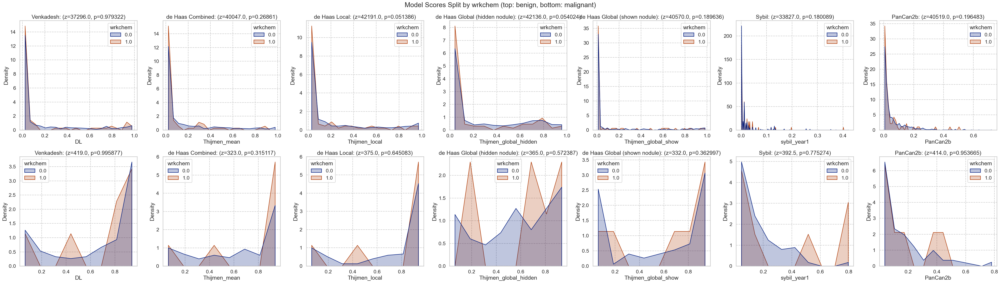

### wrkcoal

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Combined_mean,de Haas Combined_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,de Haas Global (shown nodule)_mean,de Haas Global (shown nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
0.0,1169,99.744027,126,10.778443,0.231281,0.339206,0.219887,0.31058,0.263427,0.351860,0.290738,0.336986,0.200208,0.335571,0.036493,0.089510,0.070760,0.105014
1.0,3,0.255973,1,33.333333,0.331882,0.574719,0.267460,0.45332,0.327241,0.566565,0.232286,0.324743,0.004584,0.007940,0.067607,0.098153,0.272585,0.468296


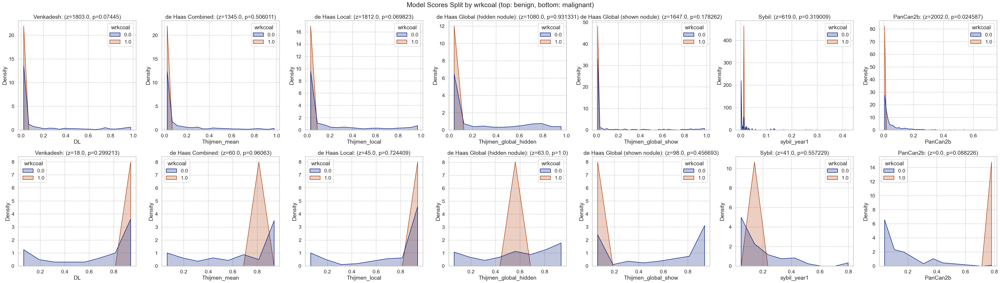

### wrkcott

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Combined_mean,de Haas Combined_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,de Haas Global (shown nodule)_mean,de Haas Global (shown nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
0.0,1164,99.317406,125,10.738832,0.231386,0.339593,0.2197,0.310525,0.263807,0.352116,0.289956,0.336602,0.198759,0.334979,0.036770,0.089770,0.071514,0.107427
1.0,8,0.682594,2,25.000000,0.253684,0.369725,0.2649,0.363213,0.232098,0.388348,0.382658,0.382038,0.337742,0.375181,0.007844,0.014774,0.036719,0.037658


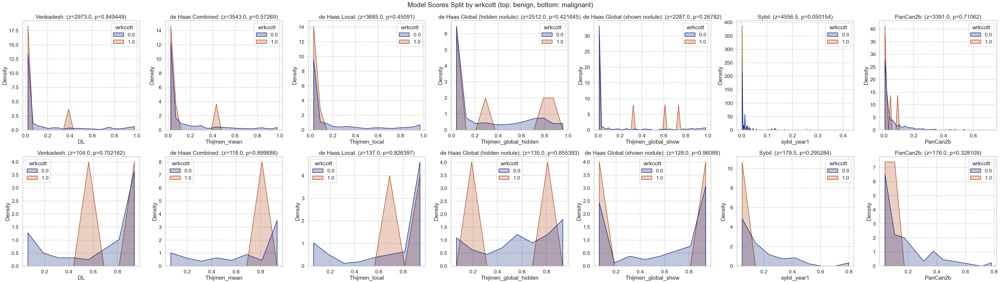

### wrkfarm

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Combined_mean,de Haas Combined_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,de Haas Global (shown nodule)_mean,de Haas Global (shown nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
0.0,1019,86.945392,119,11.678116,0.235774,0.341858,0.227354,0.314260,0.271783,0.357483,0.292227,0.334447,0.198767,0.335338,0.036931,0.088472,0.073028,0.108645
1.0,153,13.054608,8,5.228758,0.203323,0.324155,0.171091,0.282433,0.209028,0.310360,0.279674,0.353271,0.205970,0.335976,0.034190,0.096351,0.059613,0.096003


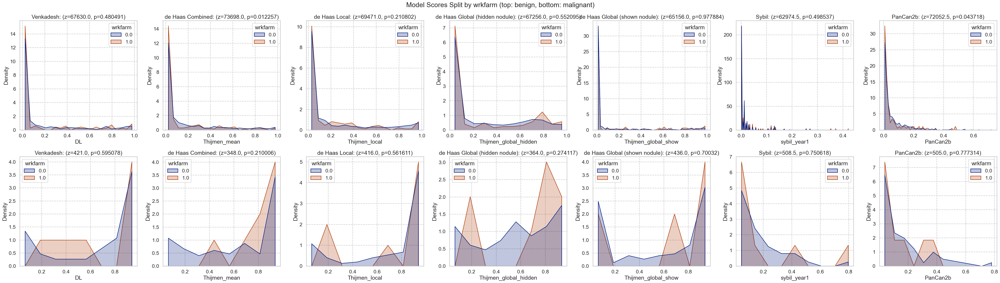

### wrkfire

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Combined_mean,de Haas Combined_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,de Haas Global (shown nodule)_mean,de Haas Global (shown nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
0.0,1153,98.37884,124,10.754553,0.232095,0.339880,0.220363,0.310864,0.264923,0.352881,0.291454,0.336730,0.200163,0.33495,0.036247,0.086951,0.071879,0.107635
1.0,19,1.62116,3,15.789474,0.197718,0.331856,0.198503,0.311698,0.182711,0.305531,0.238087,0.348298,0.172030,0.36367,0.056328,0.191925,0.034742,0.061984


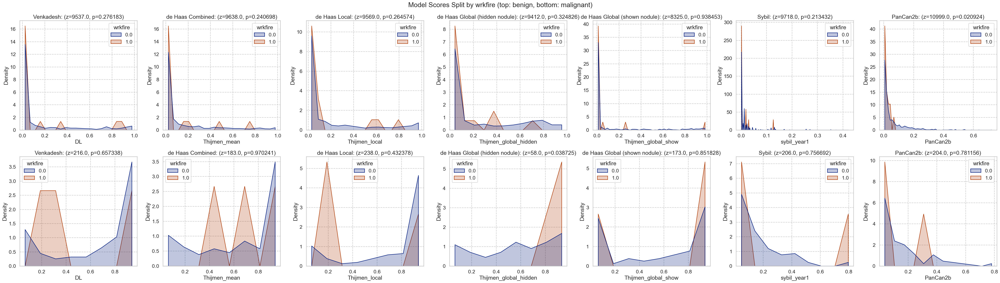

### wrkflou

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Combined_mean,de Haas Combined_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,de Haas Global (shown nodule)_mean,de Haas Global (shown nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
0.0,1153,98.37884,127,11.014744,0.232142,0.340547,0.220015,0.311513,0.264948,0.353852,0.289633,0.335469,0.199976,0.335970,0.036841,0.090122,0.070865,0.107005
1.0,19,1.62116,0,0.000000,0.194857,0.284399,0.219613,0.267977,0.181224,0.221689,0.348614,0.418251,0.183381,0.298373,0.020269,0.032226,0.096260,0.115115


C:\Users\shaur\AppData\Local\Temp\ipykernel_22244\104270355.py:16: SmallSampleWarning: One or more sample arguments is too small; all returned values will be NaN. See documentation for sample size requirements.
  res = sigtest(sample0, sample1, alternative='two-sided', nan_policy='omit')
C:\Users\shaur\AppData\Local\Temp\ipykernel_22244\104270355.py:16: SmallSampleWarning: One or more sample arguments is too small; all returned values will be NaN. See documentation for sample size requirements.
  res = sigtest(sample0, sample1, alternative='two-sided', nan_policy='omit')
C:\Users\shaur\AppData\Local\Temp\ipykernel_22244\104270355.py:16: SmallSampleWarning: One or more sample arguments is too small; all returned values will be NaN. See documentation for sample size requirements.
  res = sigtest(sample0, sample1, alternative='two-sided', nan_policy='omit')
C:\Users\shaur\AppData\Local\Temp\ipykernel_22244\104270355.py:16: SmallSampleWarning: One or more sample arguments is too small; all

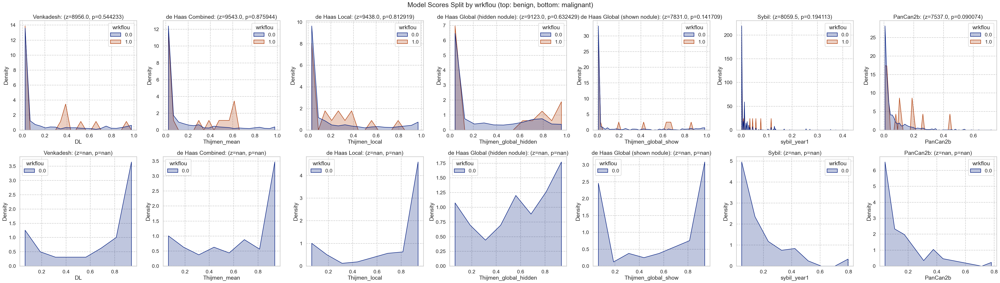

### wrkfoun

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Combined_mean,de Haas Combined_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,de Haas Global (shown nodule)_mean,de Haas Global (shown nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
0.0,1124,95.904437,116,10.320285,0.229795,0.339858,0.217503,0.308419,0.261042,0.351093,0.288416,0.335360,0.195963,0.332551,0.035447,0.085870,0.071052,0.107566
1.0,48,4.095563,11,22.916667,0.272360,0.335420,0.278687,0.359916,0.323260,0.376224,0.341472,0.369878,0.287395,0.387644,0.062927,0.150521,0.076535,0.097439


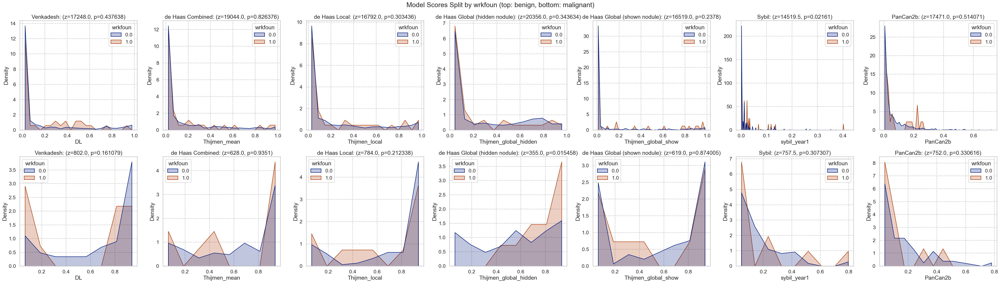

### wrkhard

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Combined_mean,de Haas Combined_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,de Haas Global (shown nodule)_mean,de Haas Global (shown nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
0.0,1162,99.146758,127,10.929432,0.232095,0.340596,0.221415,0.311630,0.264444,0.352826,0.291743,0.336995,0.200228,0.335880,0.036834,0.089841,0.071450,0.107488
1.0,10,0.853242,0,0.000000,0.166859,0.199255,0.056628,0.085101,0.164400,0.264820,0.156425,0.303308,0.139258,0.263541,0.006261,0.004763,0.051181,0.050868


C:\Users\shaur\AppData\Local\Temp\ipykernel_22244\104270355.py:16: SmallSampleWarning: One or more sample arguments is too small; all returned values will be NaN. See documentation for sample size requirements.
  res = sigtest(sample0, sample1, alternative='two-sided', nan_policy='omit')
C:\Users\shaur\AppData\Local\Temp\ipykernel_22244\104270355.py:16: SmallSampleWarning: One or more sample arguments is too small; all returned values will be NaN. See documentation for sample size requirements.
  res = sigtest(sample0, sample1, alternative='two-sided', nan_policy='omit')
C:\Users\shaur\AppData\Local\Temp\ipykernel_22244\104270355.py:16: SmallSampleWarning: One or more sample arguments is too small; all returned values will be NaN. See documentation for sample size requirements.
  res = sigtest(sample0, sample1, alternative='two-sided', nan_policy='omit')
C:\Users\shaur\AppData\Local\Temp\ipykernel_22244\104270355.py:16: SmallSampleWarning: One or more sample arguments is too small; all

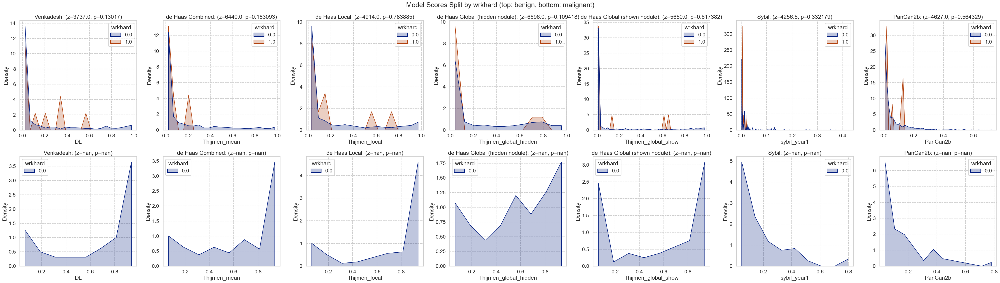

### wrkpain

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Combined_mean,de Haas Combined_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,de Haas Global (shown nodule)_mean,de Haas Global (shown nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
0.0,1099,93.771331,120,10.919017,0.228854,0.336770,0.221908,0.312607,0.263492,0.352696,0.290766,0.336387,0.197293,0.333842,0.036068,0.089187,0.07067,0.107248
1.0,73,6.228669,7,9.589041,0.271943,0.380533,0.191416,0.281840,0.265069,0.347080,0.287918,0.345860,0.236057,0.356780,0.044171,0.094420,0.08041,0.105759


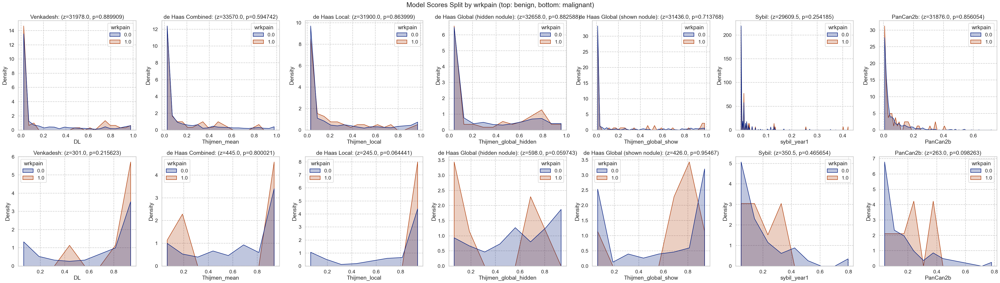

### wrksand

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Combined_mean,de Haas Combined_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,de Haas Global (shown nodule)_mean,de Haas Global (shown nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
0.0,1142,97.440273,120,10.507881,0.226982,0.336637,0.218902,0.310947,0.261720,0.351214,0.290348,0.336392,0.196238,0.332432,0.036315,0.089686,0.070481,0.106634
1.0,30,2.559727,7,23.333333,0.404960,0.409060,0.262140,0.305553,0.334794,0.387716,0.299760,0.359198,0.331783,0.415643,0.046397,0.082979,0.101585,0.122995


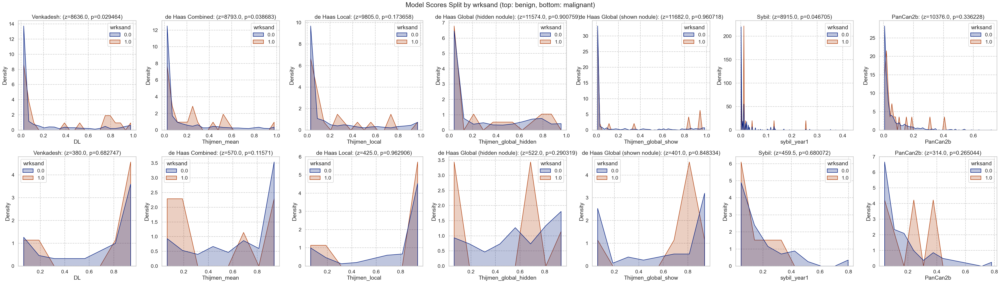

### wrkweld

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Combined_mean,de Haas Combined_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,de Haas Global (shown nodule)_mean,de Haas Global (shown nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
0.0,1092,93.174061,116,10.622711,0.224542,0.336411,0.221237,0.312065,0.260573,0.350458,0.294791,0.336767,0.195133,0.332500,0.035334,0.086070,0.070401,0.107203
1.0,80,6.825939,11,13.750000,0.327027,0.370220,0.203249,0.293659,0.304777,0.375114,0.233221,0.334586,0.262154,0.367829,0.053483,0.126973,0.083232,0.106177


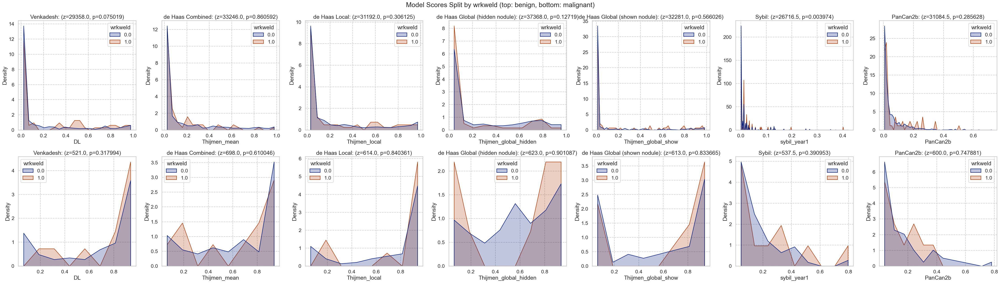

In [64]:
for cat in nlst_democols['cat']['work']:
    plot_by_category(nlst_preds, cat)

### Disease history

### Emphysema

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Combined_mean,de Haas Combined_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,de Haas Global (shown nodule)_mean,de Haas Global (shown nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
False,733,62.542662,70,9.549795,0.216356,0.329065,0.214104,0.310660,0.255759,0.345907,0.282151,0.334439,0.182387,0.323845,0.035118,0.090800,0.062120,0.098693
True,439,37.457338,57,12.984055,0.256887,0.355540,0.229868,0.311022,0.276667,0.362494,0.304677,0.340714,0.228627,0.352047,0.039001,0.087339,0.086567,0.118467


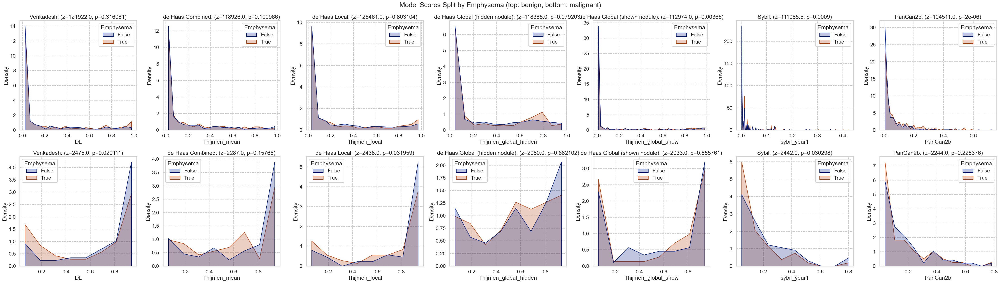

In [65]:
plot_by_category(nlst_preds, 'Emphysema')

### diagadas

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Combined_mean,de Haas Combined_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,de Haas Global (shown nodule)_mean,de Haas Global (shown nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
0.0,1102,94.027304,118,10.707804,0.220967,0.331939,0.213516,0.306955,0.255795,0.347419,0.285283,0.334244,0.195441,0.332985,0.034982,0.085729,0.070162,0.107862
1.0,70,5.972696,9,12.857143,0.397953,0.411919,0.322222,0.352369,0.386311,0.403735,0.374114,0.367850,0.266871,0.365678,0.061618,0.134156,0.088825,0.093942


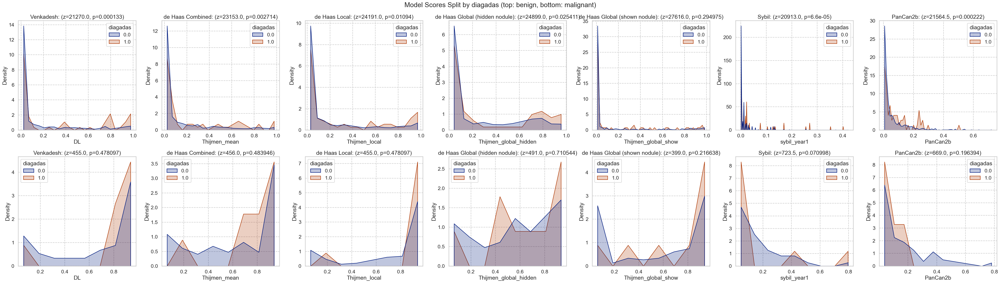

### diagasbe

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Combined_mean,de Haas Combined_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,de Haas Global (shown nodule)_mean,de Haas Global (shown nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
0.0,1147,98.034188,127,11.072363,0.232945,0.341430,0.219834,0.311206,0.264890,0.353193,0.290348,0.336148,0.198704,0.334406,0.036643,0.089594,0.071288,0.107663
1.0,23,1.965812,0,0.000000,0.181454,0.245033,0.247802,0.299963,0.220068,0.311528,0.327877,0.379303,0.267107,0.387354,0.035773,0.090286,0.065712,0.081464


C:\Users\shaur\AppData\Local\Temp\ipykernel_22244\104270355.py:16: SmallSampleWarning: One or more sample arguments is too small; all returned values will be NaN. See documentation for sample size requirements.
  res = sigtest(sample0, sample1, alternative='two-sided', nan_policy='omit')
C:\Users\shaur\AppData\Local\Temp\ipykernel_22244\104270355.py:16: SmallSampleWarning: One or more sample arguments is too small; all returned values will be NaN. See documentation for sample size requirements.
  res = sigtest(sample0, sample1, alternative='two-sided', nan_policy='omit')
C:\Users\shaur\AppData\Local\Temp\ipykernel_22244\104270355.py:16: SmallSampleWarning: One or more sample arguments is too small; all returned values will be NaN. See documentation for sample size requirements.
  res = sigtest(sample0, sample1, alternative='two-sided', nan_policy='omit')
C:\Users\shaur\AppData\Local\Temp\ipykernel_22244\104270355.py:16: SmallSampleWarning: One or more sample arguments is too small; all

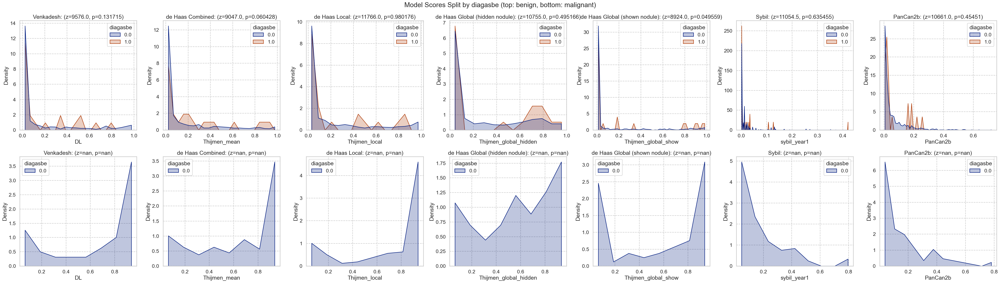

### diagbron

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Combined_mean,de Haas Combined_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,de Haas Global (shown nodule)_mean,de Haas Global (shown nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
0.0,1121,95.811966,124,11.061552,0.234747,0.342285,0.223593,0.312038,0.266463,0.352769,0.295196,0.338581,0.202211,0.336963,0.037298,0.090680,0.072486,0.108708
1.0,49,4.188034,3,6.122449,0.164260,0.272802,0.146886,0.276139,0.207032,0.341866,0.191212,0.284063,0.150518,0.298141,0.021071,0.057166,0.044055,0.059056


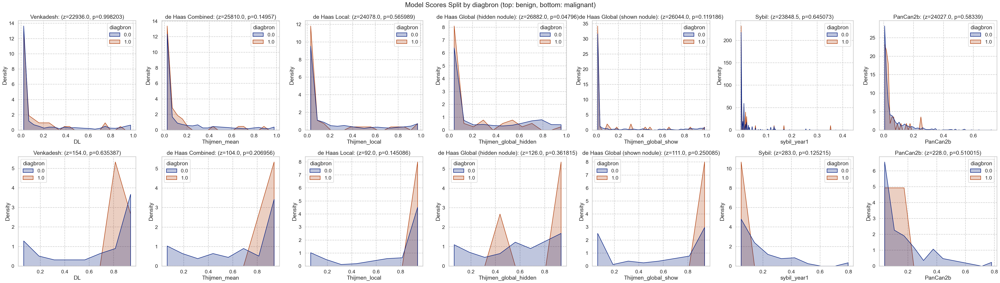

### diagchas

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Combined_mean,de Haas Combined_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,de Haas Global (shown nodule)_mean,de Haas Global (shown nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
0.0,1138,97.098976,125,10.984183,0.230967,0.339131,0.218411,0.309128,0.263904,0.351866,0.287736,0.335284,0.196312,0.332058,0.036615,0.090022,0.071637,0.107965
1.0,34,2.901024,2,5.882353,0.250655,0.361086,0.273505,0.362261,0.253087,0.368611,0.386080,0.378318,0.313363,0.419935,0.035157,0.070916,0.059215,0.074399


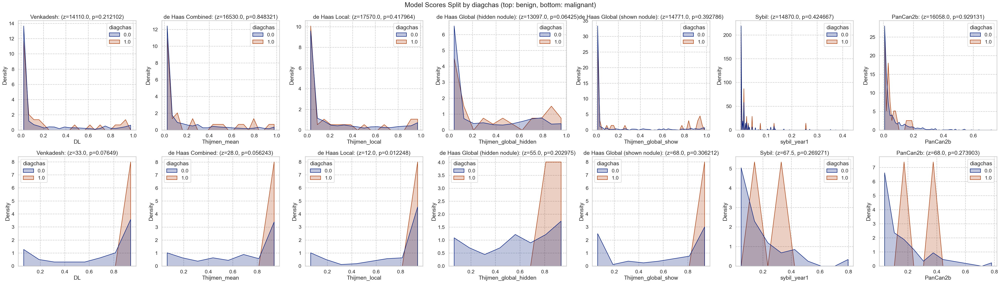

### diagchro

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Combined_mean,de Haas Combined_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,de Haas Global (shown nodule)_mean,de Haas Global (shown nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
0.0,1035,88.613014,110,10.628019,0.223269,0.332213,0.211078,0.303439,0.251950,0.346086,0.286949,0.332654,0.191430,0.327544,0.033936,0.084583,0.069791,0.104052
1.0,133,11.386986,17,12.781955,0.293857,0.392341,0.282691,0.355507,0.359293,0.388595,0.308775,0.362188,0.253359,0.382196,0.057984,0.120318,0.084354,0.129351


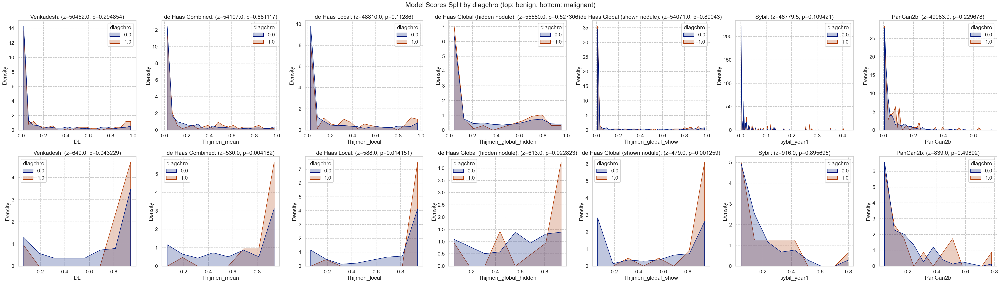

### diagcopd

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Combined_mean,de Haas Combined_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,de Haas Global (shown nodule)_mean,de Haas Global (shown nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
0.0,1088,92.991453,120,11.029412,0.226596,0.334778,0.217645,0.309311,0.257837,0.349671,0.290771,0.335212,0.201893,0.336207,0.034218,0.084412,0.067749,0.102948
1.0,82,7.008547,7,8.536585,0.291235,0.390858,0.256732,0.330973,0.334282,0.373665,0.294666,0.361265,0.175556,0.326580,0.068491,0.138052,0.117051,0.145231


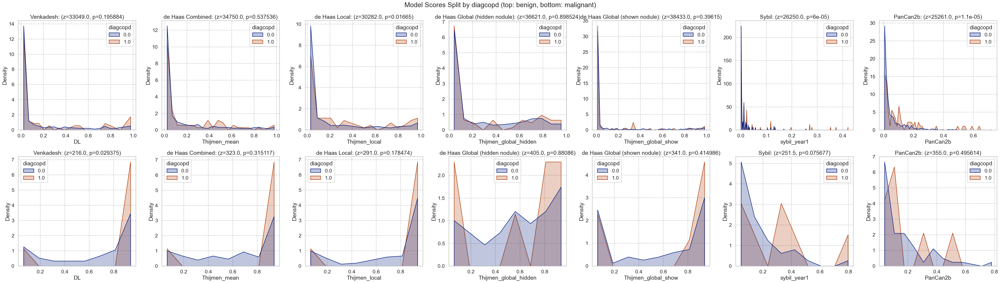

### diagdiab

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Combined_mean,de Haas Combined_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,de Haas Global (shown nodule)_mean,de Haas Global (shown nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
0.0,1046,89.249147,108,10.325048,0.234520,0.341483,0.220857,0.309702,0.263989,0.352014,0.296582,0.337642,0.200210,0.333678,0.036425,0.084898,0.072038,0.108399
1.0,126,10.750853,19,15.079365,0.206785,0.324186,0.212969,0.320556,0.260283,0.355165,0.240831,0.327134,0.195539,0.349699,0.037799,0.121589,0.064957,0.096187


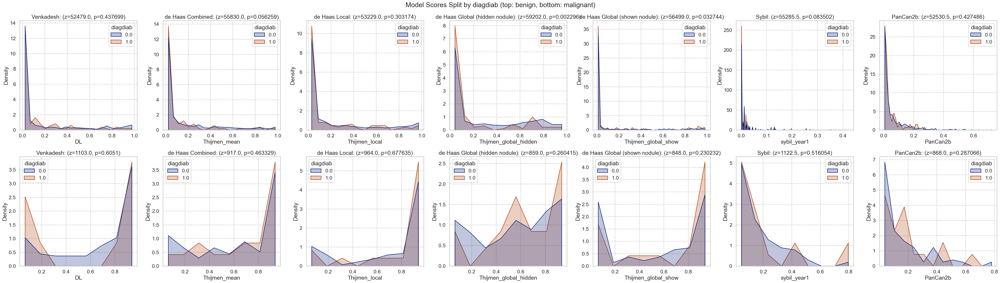

### diagemph

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Combined_mean,de Haas Combined_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,de Haas Global (shown nodule)_mean,de Haas Global (shown nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
0.0,1031,88.270548,112,10.863240,0.227148,0.336902,0.215371,0.306544,0.259993,0.349277,0.288895,0.333877,0.196156,0.330973,0.032307,0.078814,0.068382,0.104922
1.0,137,11.729452,15,10.948905,0.271098,0.361160,0.261305,0.341359,0.297626,0.375777,0.311804,0.360145,0.232266,0.368755,0.069651,0.143721,0.093023,0.121636


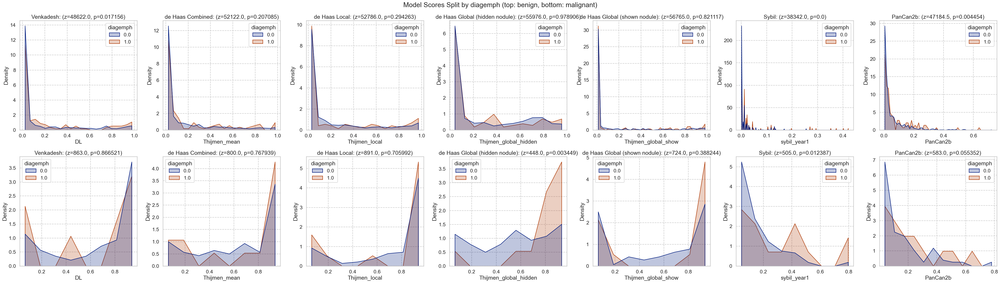

### diagfibr

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Combined_mean,de Haas Combined_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,de Haas Global (shown nodule)_mean,de Haas Global (shown nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
0.0,1166,99.488055,127,10.891938,0.230388,0.338581,0.218632,0.310275,0.262301,0.351962,0.288791,0.336377,0.198847,0.334723,0.036056,0.088523,0.071185,0.107240
1.0,6,0.511945,0,0.000000,0.455063,0.495640,0.487529,0.315072,0.514107,0.335816,0.640032,0.246420,0.366834,0.434944,0.137045,0.194979,0.089211,0.090876


C:\Users\shaur\AppData\Local\Temp\ipykernel_22244\104270355.py:16: SmallSampleWarning: One or more sample arguments is too small; all returned values will be NaN. See documentation for sample size requirements.
  res = sigtest(sample0, sample1, alternative='two-sided', nan_policy='omit')
C:\Users\shaur\AppData\Local\Temp\ipykernel_22244\104270355.py:16: SmallSampleWarning: One or more sample arguments is too small; all returned values will be NaN. See documentation for sample size requirements.
  res = sigtest(sample0, sample1, alternative='two-sided', nan_policy='omit')
C:\Users\shaur\AppData\Local\Temp\ipykernel_22244\104270355.py:16: SmallSampleWarning: One or more sample arguments is too small; all returned values will be NaN. See documentation for sample size requirements.
  res = sigtest(sample0, sample1, alternative='two-sided', nan_policy='omit')
C:\Users\shaur\AppData\Local\Temp\ipykernel_22244\104270355.py:16: SmallSampleWarning: One or more sample arguments is too small; all

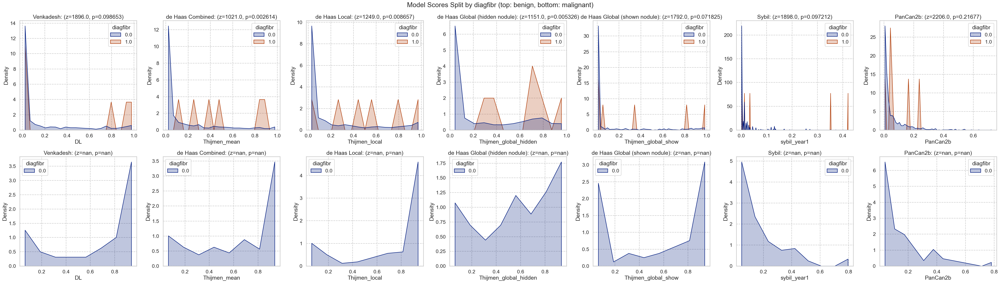

### diaghear

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Combined_mean,de Haas Combined_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,de Haas Global (shown nodule)_mean,de Haas Global (shown nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
0.0,1017,87.071918,114,11.209440,0.225319,0.335693,0.214628,0.305649,0.258825,0.351150,0.297666,0.337003,0.203366,0.336965,0.037293,0.091307,0.071737,0.107903
1.0,151,12.928082,13,8.609272,0.279550,0.365038,0.262025,0.343325,0.302425,0.360275,0.248375,0.335632,0.174950,0.323228,0.032600,0.077572,0.067914,0.103161


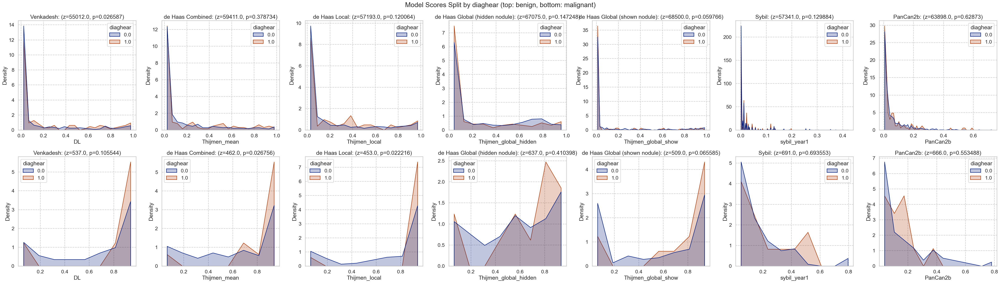

### diaghype

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Combined_mean,de Haas Combined_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,de Haas Global (shown nodule)_mean,de Haas Global (shown nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
0.0,778,66.609589,80,10.282776,0.233319,0.34297,0.206710,0.299340,0.262665,0.350204,0.284124,0.331721,0.186265,0.327731,0.036522,0.088190,0.072354,0.106539
1.0,390,33.390411,44,11.282051,0.223666,0.33003,0.241998,0.327574,0.261638,0.354459,0.299509,0.344282,0.221886,0.346127,0.035848,0.092001,0.069084,0.108901


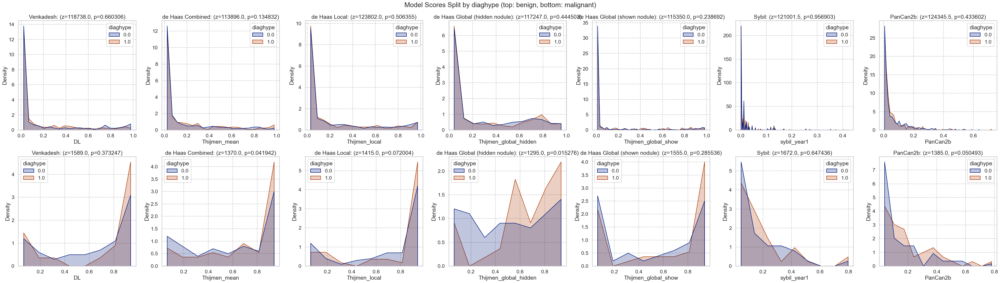

### diagpneu

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Combined_mean,de Haas Combined_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,de Haas Global (shown nodule)_mean,de Haas Global (shown nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
0.0,897,76.535836,102,11.371237,0.225621,0.337884,0.223776,0.314114,0.260328,0.351856,0.285890,0.333796,0.198655,0.333997,0.035318,0.091760,0.066055,0.099162
1.0,275,23.464164,25,9.090909,0.250837,0.345227,0.207721,0.299772,0.274232,0.353768,0.305914,0.346740,0.203139,0.340049,0.040665,0.081724,0.088310,0.128529


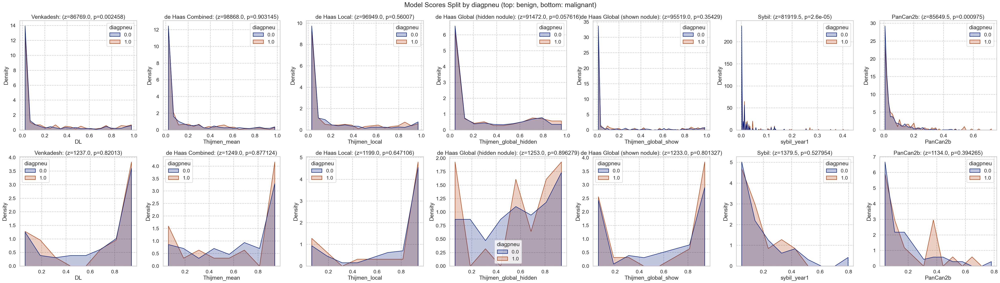

### diagsarc

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Combined_mean,de Haas Combined_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,de Haas Global (shown nodule)_mean,de Haas Global (shown nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
0.0,1170,99.829352,126,10.769231,0.230874,0.339282,0.219413,0.310667,0.263116,0.352031,0.289716,0.336459,0.199626,0.335411,0.036505,0.089534,0.070904,0.106501
1.0,2,0.170648,1,50.000000,0.619762,0.462425,0.568596,0.122999,0.541018,0.485218,0.801121,0.017900,0.247482,0.349898,0.076379,0.077428,0.289551,0.293932


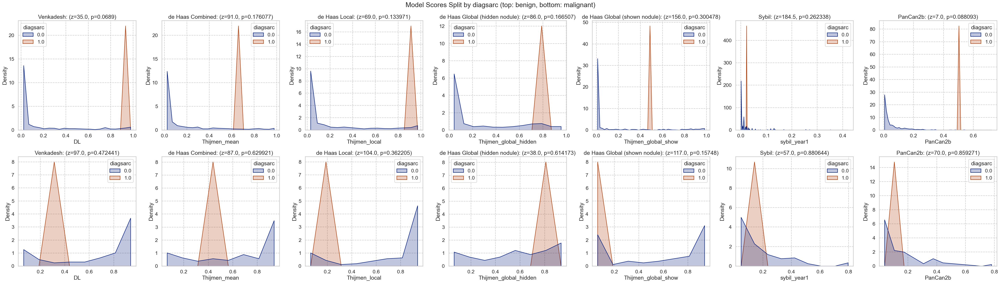

### diagsili

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Combined_mean,de Haas Combined_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,de Haas Global (shown nodule)_mean,de Haas Global (shown nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
0.0,1170,99.829352,127,10.854701,0.231863,0.339839,0.220023,0.311013,0.263896,0.352426,0.290337,0.336583,0.199760,0.335498,0.036632,0.089566,0.071330,0.107218
1.0,2,0.170648,0,0.000000,0.041241,0.023805,0.211665,0.080692,0.084503,0.022305,0.437617,0.617687,0.168907,0.238866,0.001784,0.000000,0.039891,0.026215


C:\Users\shaur\AppData\Local\Temp\ipykernel_22244\104270355.py:16: SmallSampleWarning: One or more sample arguments is too small; all returned values will be NaN. See documentation for sample size requirements.
  res = sigtest(sample0, sample1, alternative='two-sided', nan_policy='omit')
C:\Users\shaur\AppData\Local\Temp\ipykernel_22244\104270355.py:16: SmallSampleWarning: One or more sample arguments is too small; all returned values will be NaN. See documentation for sample size requirements.
  res = sigtest(sample0, sample1, alternative='two-sided', nan_policy='omit')
C:\Users\shaur\AppData\Local\Temp\ipykernel_22244\104270355.py:16: SmallSampleWarning: One or more sample arguments is too small; all returned values will be NaN. See documentation for sample size requirements.
  res = sigtest(sample0, sample1, alternative='two-sided', nan_policy='omit')
C:\Users\shaur\AppData\Local\Temp\ipykernel_22244\104270355.py:16: SmallSampleWarning: One or more sample arguments is too small; all

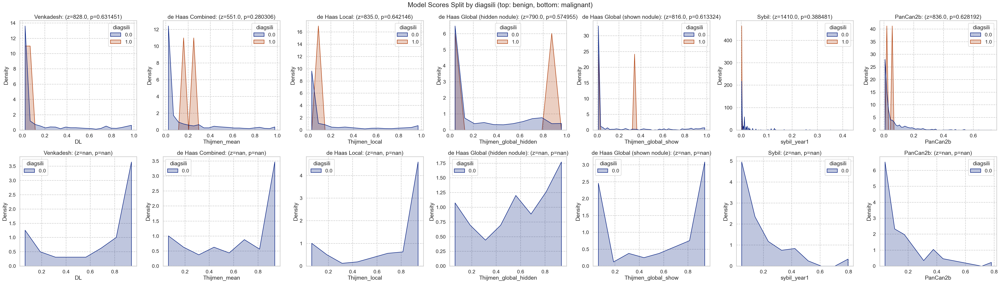

### diagstro

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Combined_mean,de Haas Combined_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,de Haas Global (shown nodule)_mean,de Haas Global (shown nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
0.0,1129,96.331058,117,10.363153,0.230592,0.338047,0.216407,0.307496,0.261317,0.349196,0.286618,0.336278,0.19315,0.330051,0.034195,0.081496,0.070683,0.106467
1.0,43,3.668942,10,23.255814,0.256365,0.382705,0.314573,0.378817,0.323291,0.424091,0.394849,0.338628,0.37187,0.420887,0.099005,0.202047,0.086870,0.123847


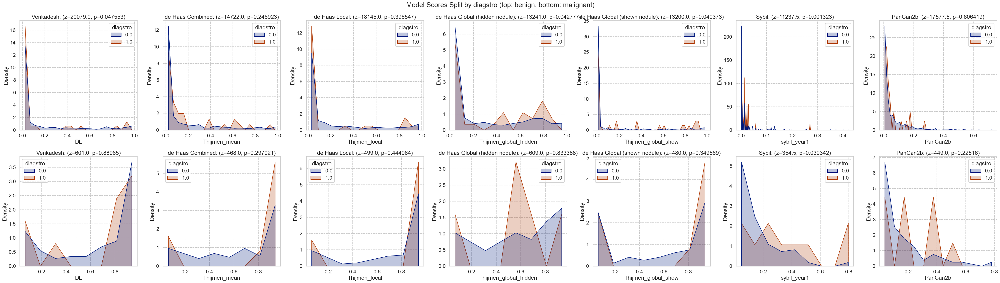

### diagtube

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Combined_mean,de Haas Combined_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,de Haas Global (shown nodule)_mean,de Haas Global (shown nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
0.0,1148,97.952218,127,11.062718,0.228645,0.339220,0.217752,0.308936,0.261023,0.350263,0.290090,0.336587,0.194689,0.331320,0.036608,0.090124,0.070594,0.106197
1.0,24,2.047782,0,0.000000,0.369941,0.337973,0.327969,0.380294,0.386371,0.425865,0.314435,0.355120,0.439763,0.433308,0.034868,0.052734,0.103932,0.144384


C:\Users\shaur\AppData\Local\Temp\ipykernel_22244\104270355.py:16: SmallSampleWarning: One or more sample arguments is too small; all returned values will be NaN. See documentation for sample size requirements.
  res = sigtest(sample0, sample1, alternative='two-sided', nan_policy='omit')
C:\Users\shaur\AppData\Local\Temp\ipykernel_22244\104270355.py:16: SmallSampleWarning: One or more sample arguments is too small; all returned values will be NaN. See documentation for sample size requirements.
  res = sigtest(sample0, sample1, alternative='two-sided', nan_policy='omit')
C:\Users\shaur\AppData\Local\Temp\ipykernel_22244\104270355.py:16: SmallSampleWarning: One or more sample arguments is too small; all returned values will be NaN. See documentation for sample size requirements.
  res = sigtest(sample0, sample1, alternative='two-sided', nan_policy='omit')
C:\Users\shaur\AppData\Local\Temp\ipykernel_22244\104270355.py:16: SmallSampleWarning: One or more sample arguments is too small; all

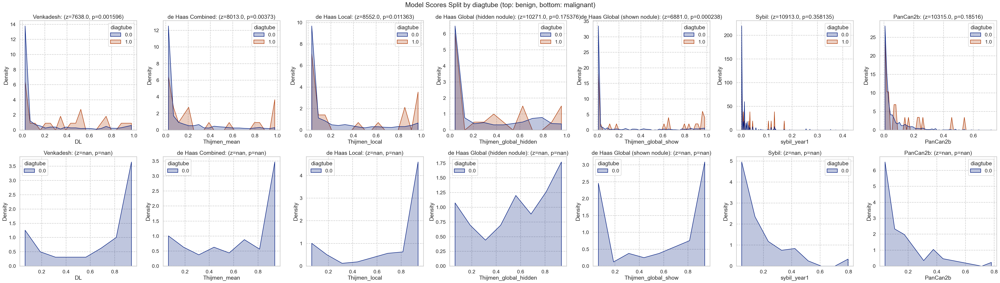

In [66]:
for cat in nlst_democols['cat']['disease']:
    plot_by_category(nlst_preds, cat)

## Binning for numerical columns

### Demographic columns

#### height

,count,mean,std,min,25%,50%,75%,max
label,,,,,,,,
0,1045.0,68.096651,3.856283,59.0,65.0,68.0,71.0,78.0
1,127.0,68.417323,3.736225,60.0,66.0,69.0,71.0,76.0


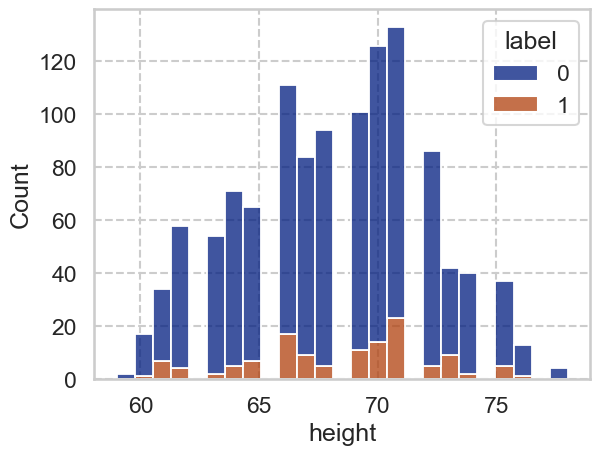

#### weight

,count,mean,std,min,25%,50%,75%,max
label,,,,,,,,
0,1044.0,183.356322,39.848243,90.0,157.0,180.0,206.0,315.0
1,127.0,178.244094,36.405720,108.0,157.0,180.0,200.0,322.0


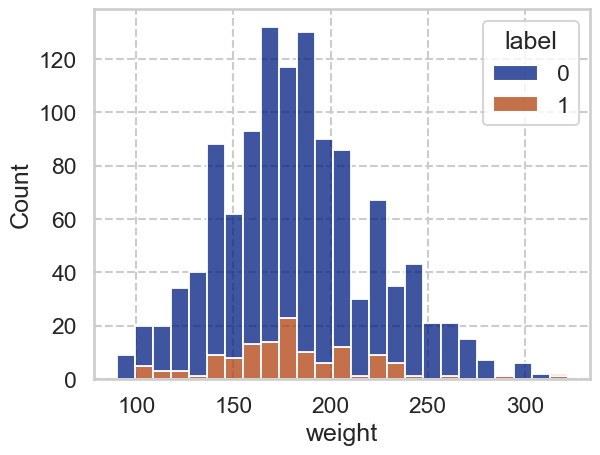

#### Age

,count,mean,std,min,25%,50%,75%,max
label,,,,,,,,
0,1045.0,63.199043,5.379523,55.0,59.0,62.0,67.0,76.0
1,127.0,64.062992,5.226228,55.0,60.5,63.0,68.0,75.0


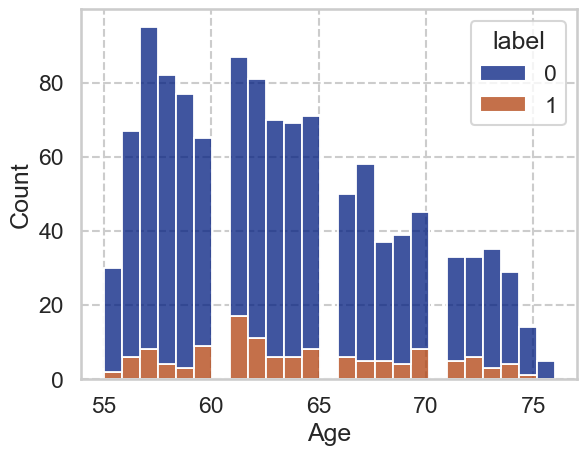

In [67]:
for c in nlst_democols['num']['demo']:
    display(Markdown(f"#### {c}"))
    display(nlst_preds.groupby('label')[c].describe())
    sns.histplot(nlst_preds, x=c, bins=25, hue="label", multiple='stack')
    plt.show()

,count,mean,std,min,25%,50%,75%,max
bin_Age,,,,,,,,
0,654.0,0.100917,0.301450,0.0,0.0,0.0,0.0,1.0
1,518.0,0.117761,0.322636,0.0,0.0,0.0,0.0,1.0


### bin_Age

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Combined_mean,de Haas Combined_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,de Haas Global (shown nodule)_mean,de Haas Global (shown nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
0,654,55.802048,66,10.091743,0.202261,0.321762,0.208263,0.305211,0.244287,0.345055,0.287503,0.331864,0.200510,0.337915,0.031350,0.078560,0.061762,0.096217
1,518,44.197952,61,11.776062,0.268502,0.357857,0.234839,0.317295,0.287962,0.359883,0.294484,0.343290,0.198695,0.332261,0.043167,0.101343,0.083289,0.118516


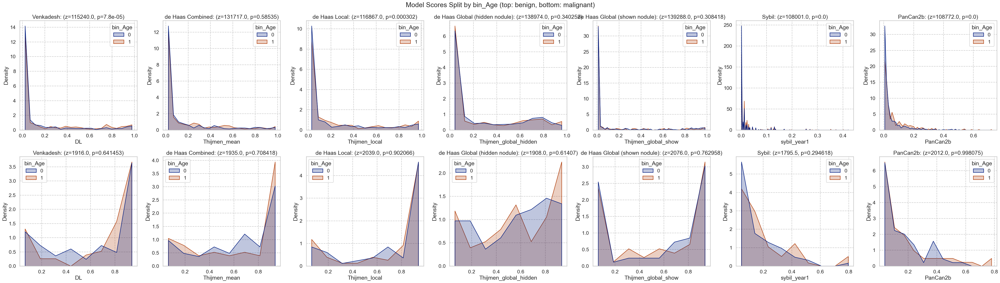

In [68]:
# nlst_preds['bin_Age'] = pd.cut(nlst_preds['Age'], bins=[55, 60, 65, 70, 78], right=False)
nlst_preds['bin_Age'] = pd.qcut(nlst_preds['Age'], q=2, labels=False)
display(nlst_preds.groupby('bin_Age')['label'].describe())
plot_by_category(nlst_preds, f'bin_Age')

label                                              height  \
            count      mean       std  min  25%  50%  75%  max  count   
bin_height                                                              
0           590.0  0.096610  0.295677  0.0  0.0  0.0  0.0  1.0  590.0   
1           582.0  0.120275  0.325563  0.0  0.0  0.0  0.0  1.0  582.0   

                                                               
                 mean       std   min   25%   50%   75%   max  
bin_height                                                     
0           64.957627  2.309624  59.0  63.0  65.0  67.0  68.0  
1           71.348797  1.939797  69.0  70.0  71.0  72.0  78.0

### bin_height

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Combined_mean,de Haas Combined_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,de Haas Global (shown nodule)_mean,de Haas Global (shown nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
0,590,50.341297,57,9.661017,0.243364,0.347994,0.219117,0.305988,0.268137,0.358157,0.302441,0.334558,0.200816,0.334123,0.039748,0.099902,0.081800,0.116877
1,582,49.658703,70,12.027491,0.219549,0.330826,0.220913,0.315778,0.258982,0.346310,0.278573,0.338992,0.198584,0.336746,0.033354,0.077503,0.060609,0.095182


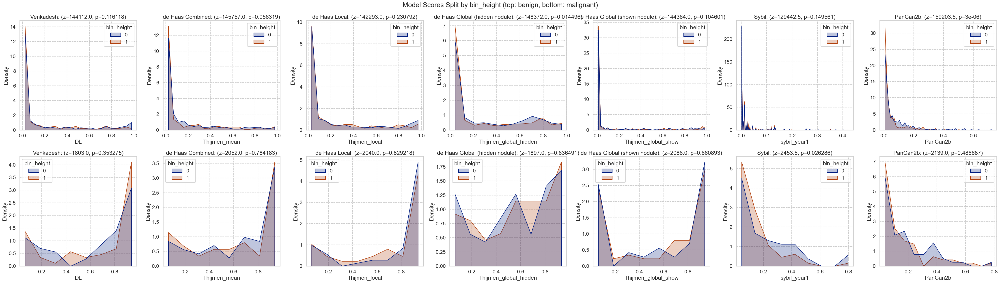

In [69]:
nlst_preds['bin_height'] = pd.cut(nlst_preds['height'], bins=[48, 68, 88], right=True, labels=False)
display(nlst_preds.groupby('bin_height')[['label', 'height']].describe())
plot_by_category(nlst_preds, f'bin_height')

label                                              weight  \
            count      mean       std  min  25%  50%  75%  max  count   
bin_weight                                                              
0.0         565.0  0.107965  0.310611  0.0  0.0  0.0  0.0  1.0  565.0   
1.0         588.0  0.108844  0.311708  0.0  0.0  0.0  0.0  1.0  588.0   

                                                                      
                  mean        std    min    25%    50%    75%    max  
bin_weight                                                            
0.0         150.851327  20.469988   90.0  139.0  155.0  168.0  178.0  
1.0         210.079932  24.316386  180.0  190.0  204.0  225.0  275.0

### bin_weight

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Combined_mean,de Haas Combined_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,de Haas Global (shown nodule)_mean,de Haas Global (shown nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
0.0,565,49.002602,61,10.796460,0.252876,0.355891,0.237731,0.319994,0.286147,0.366751,0.310879,0.332642,0.215331,0.340225,0.040109,0.092778,0.082582,0.115284
1.0,588,50.997398,64,10.884354,0.210299,0.322147,0.204420,0.300846,0.239725,0.335339,0.275578,0.340404,0.184942,0.329773,0.032905,0.086193,0.060362,0.097905


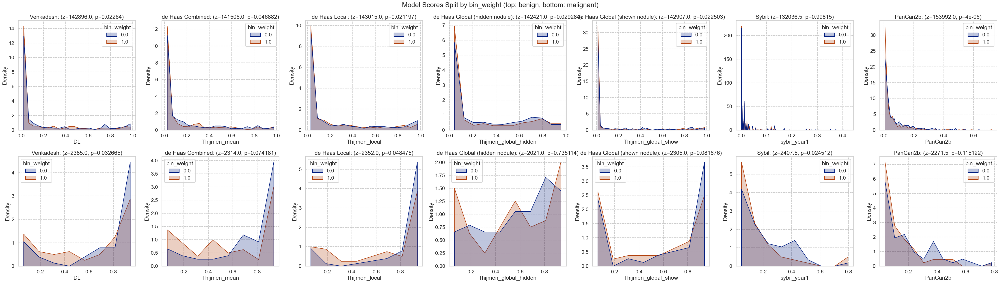

In [70]:
nlst_preds['bin_weight'] = pd.cut(nlst_preds['weight'], bins=[79, 179, 279], right=True, labels=False)
display(nlst_preds.groupby('bin_weight')[['label', 'weight']].describe())
plot_by_category(nlst_preds, f'bin_weight')

### Smoking columns

#### pkyr

,count,mean,std,min,25%,50%,75%,max
label,,,,,,,,
0,1045.0,56.656603,22.031699,30.0,40.00,50.0,67.50,162.0
1,127.0,70.186220,29.608258,30.0,49.75,64.5,84.75,224.0


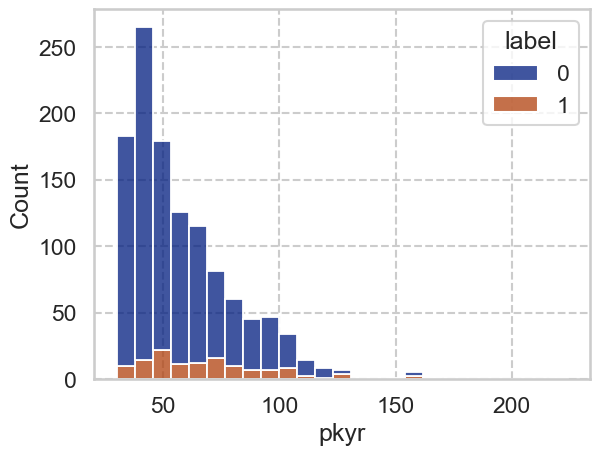

#### smokeage

,count,mean,std,min,25%,50%,75%,max
label,,,,,,,,
0,1045.0,16.448804,3.476042,5.0,14.0,16.0,18.0,40.0
1,127.0,16.220472,3.231574,8.0,14.0,16.0,18.0,26.0


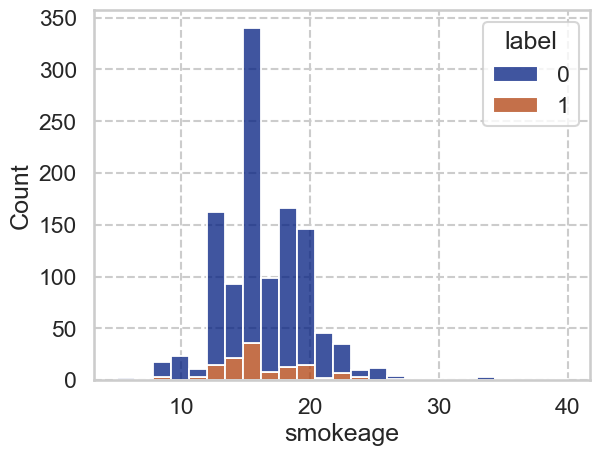

#### smokeday

,count,mean,std,min,25%,50%,75%,max
label,,,,,,,,
0,1045.0,28.328230,11.434740,12.0,20.0,25.0,32.0,80.0
1,127.0,31.818898,12.065573,18.0,20.0,30.0,40.0,80.0


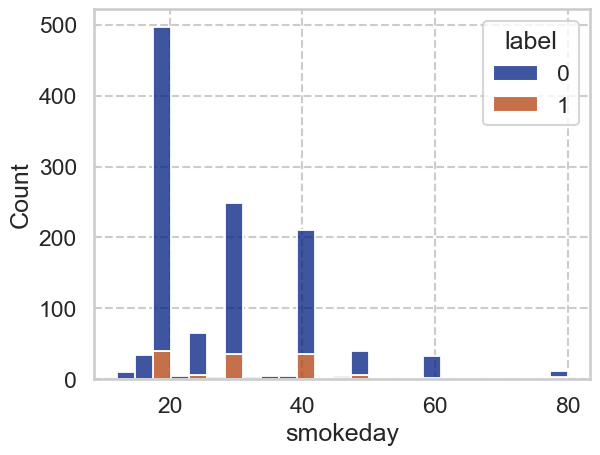

#### smokeyr

,count,mean,std,min,25%,50%,75%,max
label,,,,,,,,
0,1045.0,40.886124,7.696808,17.0,36.0,41.0,46.0,61.0
1,127.0,44.086614,7.219928,29.0,39.0,44.0,49.0,65.0


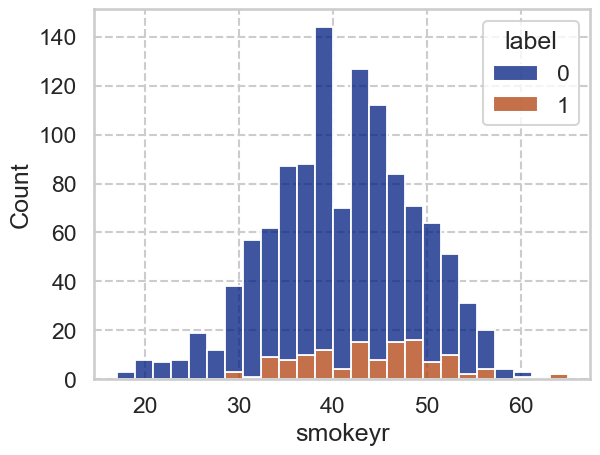

In [71]:
for c in nlst_democols['num']['smoke']:
    display(Markdown(f"#### {c}"))
    display(nlst_preds.groupby('label')[c].describe())
    sns.histplot(nlst_preds, x=c, bins=25, hue="label", multiple='stack')
    plt.show()

label                                                pkyr  \
          count      mean       std  min  25%  50%  75%  max  count   
bin_pkyr                                                              
0         601.0  0.063228  0.243575  0.0  0.0  0.0  0.0  1.0  601.0   
1         571.0  0.155867  0.363047  0.0  0.0  0.0  0.0  1.0  571.0   

                                                               
               mean        std   min   25%   50%   75%    max  
bin_pkyr                                                       
0         40.953411   6.072504  30.0  36.0  41.0  46.0   52.0  
1         76.194046  21.033603  52.5  60.0  70.0  88.0  224.0

### bin_pkyr

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Combined_mean,de Haas Combined_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,de Haas Global (shown nodule)_mean,de Haas Global (shown nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
0,601,51.279863,38,6.322795,0.198295,0.321997,0.198341,0.296435,0.236620,0.337123,0.276131,0.327125,0.175446,0.317725,0.031786,0.087086,0.065494,0.099909
1,571,48.720137,89,15.586690,0.266527,0.354196,0.242815,0.323847,0.291977,0.365559,0.305806,0.346397,0.225243,0.351300,0.041611,0.091782,0.077363,0.114024


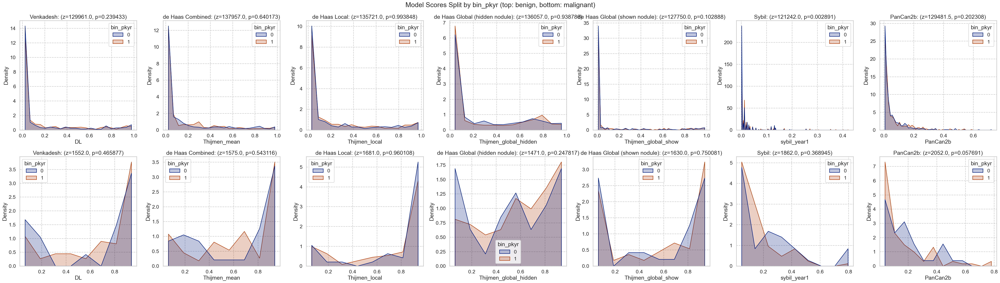

label                                              smokeage  \
              count      mean       std  min  25%  50%  75%  max    count   
bin_smokeage                                                                
0             648.0  0.120370  0.325646  0.0  0.0  0.0  0.0  1.0    648.0   
1             524.0  0.093511  0.291426  0.0  0.0  0.0  0.0  1.0    524.0   

                                                                 
                   mean       std   min   25%   50%   75%   max  
bin_smokeage                                                     
0             14.074074  1.907621   5.0  13.0  15.0  16.0  16.0  
1             19.330153  2.615545  17.0  18.0  18.0  20.0  40.0

### bin_smokeage

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Combined_mean,de Haas Combined_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,de Haas Global (shown nodule)_mean,de Haas Global (shown nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
0,648,55.290102,78,12.037037,0.231283,0.333777,0.220147,0.303326,0.262159,0.344847,0.295913,0.341768,0.226188,0.348302,0.035379,0.080670,0.073422,0.109964
1,524,44.709898,49,9.351145,0.231853,0.347076,0.219838,0.319999,0.265360,0.361416,0.284004,0.330839,0.166960,0.315725,0.038049,0.099404,0.068624,0.103578


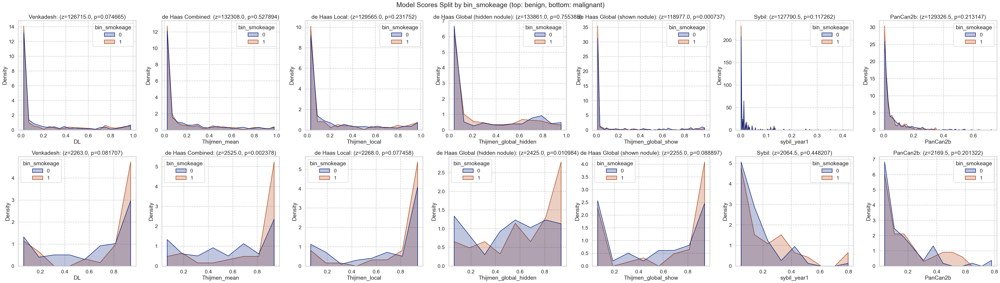

label                                              smokeday  \
              count      mean       std  min  25%  50%  75%  max    count   
bin_smokeday                                                                
0             611.0  0.075286  0.264069  0.0  0.0  0.0  0.0  1.0    611.0   
1             561.0  0.144385  0.351793  0.0  0.0  0.0  0.0  1.0    561.0   

                                                                  
                   mean        std   min   25%   50%   75%   max  
bin_smokeday                                                      
0             20.081833   2.207256  12.0  20.0  20.0  20.0  25.0  
1             38.099822  10.204027  28.0  30.0  40.0  40.0  80.0

### bin_smokeday

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Combined_mean,de Haas Combined_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,de Haas Global (shown nodule)_mean,de Haas Global (shown nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
0,611,52.133106,46,7.528642,0.208967,0.327902,0.209231,0.298299,0.247532,0.343721,0.282534,0.329729,0.177545,0.320568,0.031479,0.082328,0.069264,0.102956
1,561,47.866894,81,14.438503,0.256120,0.350623,0.231747,0.323639,0.281080,0.360709,0.299362,0.344488,0.223845,0.349304,0.042121,0.096480,0.073469,0.111564


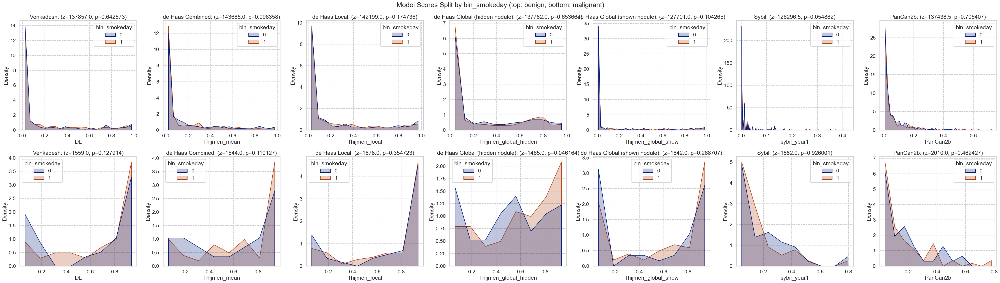

label                                              smokeyr  \
             count      mean       std  min  25%  50%  75%  max   count   
bin_smokeyr                                                               
0            603.0  0.077944  0.268305  0.0  0.0  0.0  0.0  1.0   603.0   
1            569.0  0.140598  0.347912  0.0  0.0  0.0  0.0  1.0   569.0   

                                                                
                  mean       std   min   25%   50%   75%   max  
bin_smokeyr                                                     
0            35.368159  5.119546  17.0  32.0  37.0  40.0  41.0  
1            47.448155  4.416024  42.0  44.0  46.0  50.0  65.0

### bin_smokeyr

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Combined_mean,de Haas Combined_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,de Haas Global (shown nodule)_mean,de Haas Global (shown nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
0,603,51.450512,47,7.794362,0.207486,0.324254,0.194673,0.297575,0.235015,0.336054,0.283451,0.330844,0.185109,0.326930,0.033980,0.087885,0.062626,0.098000
1,569,48.549488,80,14.059754,0.257027,0.353724,0.246859,0.322234,0.293873,0.366415,0.298152,0.343199,0.215178,0.343532,0.039321,0.091180,0.080445,0.115419


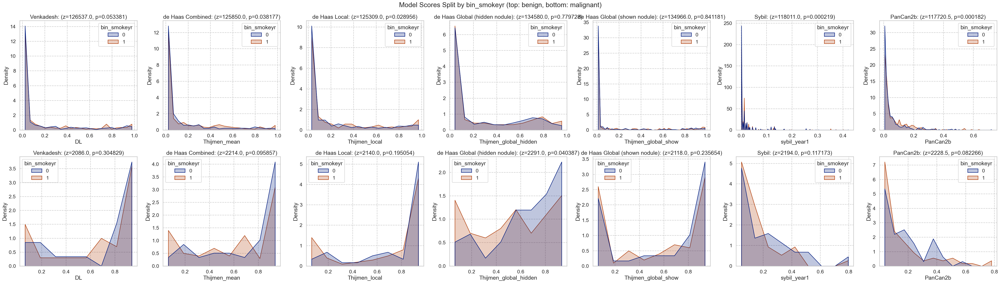

In [72]:
for c in nlst_democols['num']['smoke']:
    nlst_preds[f'bin_{c}'] = pd.qcut(nlst_preds[c], q=2, labels=False)
    display(nlst_preds.groupby(f'bin_{c}')[['label', f'{c}']].describe())
    plot_by_category(nlst_preds, f'bin_{c}')

### Included columns from predictions

#### Diameter [mm]

,count,mean,std,min,25%,50%,75%,max
label,,,,,,,,
0,1045.0,8.728517,5.254231,4.0,5.50,7.2,9.8,44.4
1,127.0,15.087402,11.924804,4.2,7.95,11.4,17.6,83.0


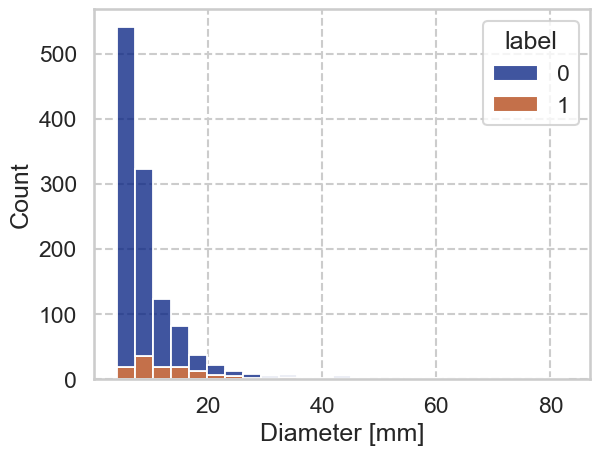

#### NoduleCounts

,count,mean,std,min,25%,50%,75%,max
label,,,,,,,,
0,1045.0,1.814354,1.255633,1.0,1.0,1.0,2.0,11.0
1,127.0,2.448819,1.541534,1.0,2.0,2.0,3.0,10.0


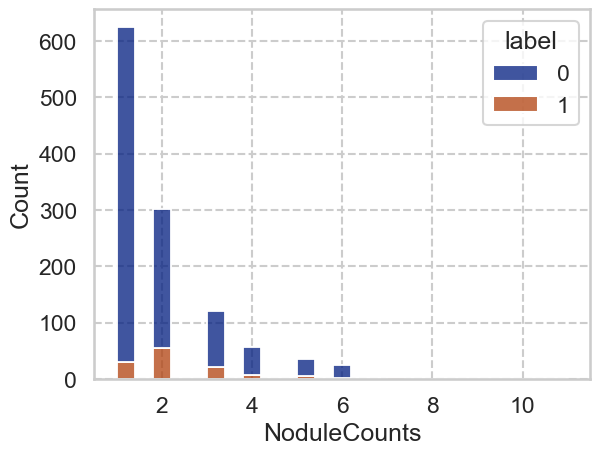

In [73]:
included_num_cols = ["Diameter [mm]", "NoduleCounts"]
for c in included_num_cols:
    display(Markdown(f"#### {c}"))
    display(nlst_preds.groupby('label')[c].describe())
    sns.histplot(nlst_preds, x=c, bins=25, hue="label", multiple='stack')
    plt.show()

label                                               \
                  count      mean       std  min  25%  50%  75%  max   
bin_NoduleCounts                                                       
0                 625.0  0.049600  0.217291  0.0  0.0  0.0  0.0  1.0   
1                 547.0  0.175503  0.380745  0.0  0.0  0.0  0.0  1.0   

                 NoduleCounts                                                
                        count      mean       std  min  25%  50%  75%   max  
bin_NoduleCounts                                                             
0                       625.0  1.000000  0.000000  1.0  1.0  1.0  1.0   1.0  
1                       547.0  2.892139  1.316725  2.0  2.0  2.0  3.0  11.0

### bin_NoduleCounts

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Combined_mean,de Haas Combined_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,de Haas Global (shown nodule)_mean,de Haas Global (shown nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
0,625,53.327645,31,4.960000,0.161290,0.287041,0.195525,0.286207,0.186288,0.304554,0.403139,0.344993,0.248162,0.354556,0.024288,0.062433,0.062037,0.094233
1,547,46.672355,96,17.550274,0.311803,0.375682,0.247984,0.334702,0.351916,0.381290,0.161989,0.276115,0.144343,0.302774,0.050610,0.111154,0.081834,0.119414


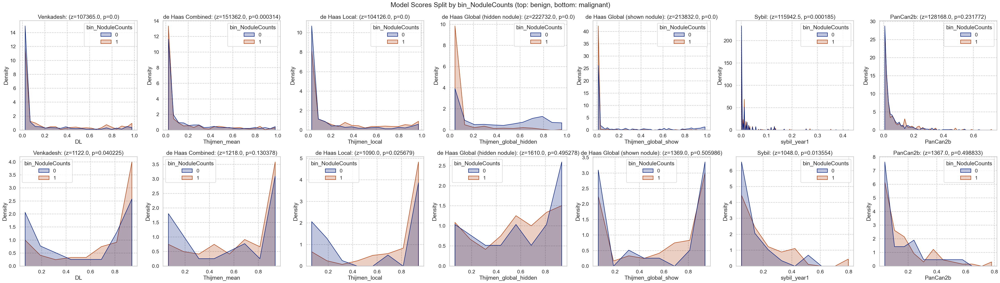

In [74]:
# for c in included_num_cols:
#     nlst_preds[f'bin_{c}'] = pd.qcut(nlst_preds[c], q=2, duplicates='drop')
#     display(nlst_preds.groupby(f'bin_{c}')[['label', f'{c}']].describe())
#     plot_by_category(nlst_preds, f'bin_{c}')
nlst_preds['bin_NoduleCounts'] = pd.cut(nlst_preds['NoduleCounts'], bins=[0, 1, 12], right=True, labels=False)
display(nlst_preds.groupby(f'bin_NoduleCounts')[['label', f'NoduleCounts']].describe())
plot_by_category(nlst_preds, f'bin_NoduleCounts')

label                                               \
                   count      mean       std  min  25%  50%  75%  max   
bin_Diameter [mm]                                                       
0                  598.0  0.045151  0.207808  0.0  0.0  0.0  0.0  1.0   
1                  574.0  0.174216  0.379626  0.0  0.0  0.0  0.0  1.0   

                  Diameter [mm]                                             \
                          count       mean       std  min  25%   50%   75%   
bin_Diameter [mm]                                                            
0                         598.0   5.679599  1.016325  4.0  4.8   5.7   6.5   
1                         574.0  13.311847  7.662230  7.6  8.8  10.9  14.9   

                         
                    max  
bin_Diameter [mm]        
0                   7.5  
1                  83.0

### bin_Diameter [mm]

,num,pct,num_mal,pct_mal,Venkadesh_mean,Venkadesh_std,de Haas Combined_mean,de Haas Combined_std,de Haas Local_mean,de Haas Local_std,de Haas Global (hidden nodule)_mean,de Haas Global (hidden nodule)_std,de Haas Global (shown nodule)_mean,de Haas Global (shown nodule)_std,Sybil_mean,Sybil_std,PanCan2b_mean,PanCan2b_std
0,598,51.023891,27,4.515050,0.074123,0.188338,0.10397,0.207851,0.104146,0.222966,0.255261,0.315450,0.117677,0.25925,0.008403,0.027002,0.013147,0.012367
1,574,48.976109,100,17.421603,0.395535,0.382080,0.34090,0.351637,0.429701,0.384106,0.327394,0.354301,0.285168,0.38128,0.065921,0.117982,0.131837,0.126877


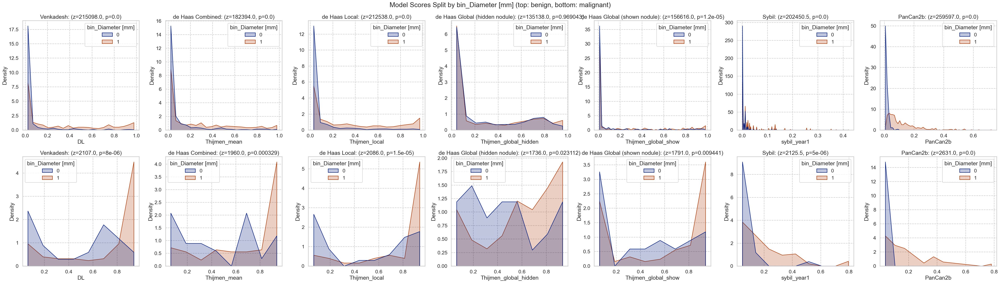

In [75]:
nlst_preds['bin_Diameter [mm]'] = pd.qcut(nlst_preds['Diameter [mm]'], q=2, labels=False)
display(nlst_preds.groupby(f'bin_Diameter [mm]')[['label', f'Diameter [mm]']].describe())
plot_by_category(nlst_preds, f'bin_Diameter [mm]')